<a href="https://colab.research.google.com/github/Devi-Prasad-G/image_classification_problem_using_limited_data/blob/main/adv_sol1(Reptile).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import random
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_datasets as tfds

In [ ]:
#parameters for mini imagenet
learning_rate = 0.001  #adam
meta_step_size = 1

inner_batch_size = 10
eval_batch_size = 15

meta_iters = 100000
eval_iters = 50
inner_iters = 8

eval_interval = 1
train_shots = 15
shots = 5
classes = 5

In [ ]:
learning_rate = 0.003
meta_step_size = 0.25

inner_batch_size = 25
eval_batch_size = 25

meta_iters = 2000
eval_iters = 5
inner_iters = 4

eval_interval = 1
train_shots = 20
shots = 5
classes = 5

## Loading the train data

In [ ]:
!unzip -qq /content/drive/MyDrive/train_resized.zip -d /content # to unzip the training file in drive

In [ ]:
!mkdir train_res

In [ ]:
!mv  -v /content/train_resized /content/train_res

renamed '/content/train_resized' -> '/content/train_res/train_resized'


In [ ]:
!mv -v /content/train_res/train_resized /content/train_res/train

renamed '/content/train_res/train_resized' -> '/content/train_res/train'


## Loading the test data

In [ ]:
!unzip -qq /content/drive/MyDrive/test_resized.zip -d /content # to unzip the training file in drive

In [ ]:
!mkdir test_res

In [ ]:
!mv  -v /content/test_resized /content/test_res

renamed '/content/test_resized' -> '/content/test_res/test_resized'


In [ ]:
split = (
    tfds.core.ReadInstruction(
        'train',
        from_=90,
        to=100,
        unit='%',
    ))

In [ ]:
builder = tfds.ImageFolder('/content/train_res',shape = (224,224,3))
#builder = tfds.TranslateFolder(root_dir='/content/test_res')
print(builder.info)  # num examples, labels... are automatically calculated
ds = builder.as_dataset(split = split,as_supervised = True,batch_size=-1,shuffle_files = False)
#assert isinstance(ds,tf.data.Dataset)
#tfds.show_examples(ds, builder.info)
print(type(ds))

tfds.core.DatasetInfo(
    name='image_folder',
    version=1.0.0,
    description='Generic image classification dataset.',
    homepage='https://www.tensorflow.org/datasets/catalog/image_folder',
    features=FeaturesDict({
        'image': Image(shape=(224, 224, 3), dtype=tf.uint8),
        'image/filename': Text(shape=(), dtype=tf.string),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=1000),
    }),
    total_num_examples=50000,
    splits={
        'train': 50000,
    },
    supervised_keys=('image', 'label'),
    citation="""""",
    redistribution_info=,
)



ValueError: ignored

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Experiments

In [ ]:
builder = tfds.ImageFolder('./train_res',shape = (224,224,3))
print(builder.info)  # num examples, labels... are automatically calculated
ds = builder.as_dataset(split = "train",as_supervised = True,batch_size=-1,shuffle_files = False)
#assert isinstance(ds,tf.data.Dataset)
#tfds.show_examples(ds, builder.info)
print(type(ds))

tfds.core.DatasetInfo(
    name='image_folder',
    version=1.0.0,
    description='Generic image classification dataset.',
    homepage='https://www.tensorflow.org/datasets/catalog/image_folder',
    features=FeaturesDict({
        'image': Image(shape=(224, 224, 3), dtype=tf.uint8),
        'image/filename': Text(shape=(), dtype=tf.string),
        'label': ClassLabel(shape=(), dtype=tf.int64, num_classes=1000),
    }),
    total_num_examples=50000,
    splits={
        'train': 50000,
    },
    supervised_keys=('image', 'label'),
    citation="""""",
    redistribution_info=,
)

Instructions for updating:
Use `tf.data.Dataset.get_single_element()`.


Instructions for updating:
Use `tf.data.Dataset.get_single_element()`.


<class 'tuple'>


In [ ]:
print(ds[0].shape,type(ds[0]))

(50000, 224, 224, 3) <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
print(ds[1].shape,type(ds[1]))

(50000,) <class 'tensorflow.python.framework.ops.EagerTensor'>


In [ ]:
print(ds[0].shape)

(50000, 224, 224, 3)


In [ ]:
print(ds[1].shape)
print(ds[1])

(50000,)
tf.Tensor([924 455 795 ... 793 402 130], shape=(50000,), dtype=int64)


In [ ]:
labels = np.array(ds[1]).tolist()

In [ ]:
data = dict.fromkeys(list(range(0,1000)))
for i in range(50000):
  if(data[labels[i]] == None):
    data[labels[i]] = []
  data[labels[i]].append(np.array(ds[0][i]))
#print(data)

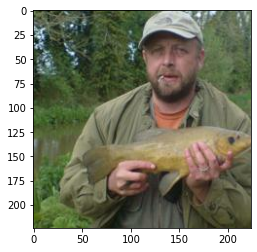

In [ ]:
len(data[0])
plt.imshow(data[0][5])

In [ ]:
d = dict.fromkeys(list(map(str,range(1,1001))))
print(d)

{'1': None, '2': None, '3': None, '4': None, '5': None, '6': None, '7': None, '8': None, '9': None, '10': None, '11': None, '12': None, '13': None, '14': None, '15': None, '16': None, '17': None, '18': None, '19': None, '20': None, '21': None, '22': None, '23': None, '24': None, '25': None, '26': None, '27': None, '28': None, '29': None, '30': None, '31': None, '32': None, '33': None, '34': None, '35': None, '36': None, '37': None, '38': None, '39': None, '40': None, '41': None, '42': None, '43': None, '44': None, '45': None, '46': None, '47': None, '48': None, '49': None, '50': None, '51': None, '52': None, '53': None, '54': None, '55': None, '56': None, '57': None, '58': None, '59': None, '60': None, '61': None, '62': None, '63': None, '64': None, '65': None, '66': None, '67': None, '68': None, '69': None, '70': None, '71': None, '72': None, '73': None, '74': None, '75': None, '76': None, '77': None, '78': None, '79': None, '80': None, '81': None, '82': None, '83': None, '84': None, 

In [ ]:
x = list(range(1,10))

In [ ]:
print(x)
x = list(map(str,x))
print(x)

[1, 2, 3, 4, 5, 6, 7, 8, 9]
['1', '2', '3', '4', '5', '6', '7', '8', '9']


In [ ]:
a_list = np.array(ds[1]).tolist()

In [ ]:
len(a_list)
print(a_list.count(100))

50


In [ ]:
b_list = np.array(ds[0]).tolist()

# Defining Dataset

In [ ]:
#referenced from keras blog post https://keras.io/examples/vision/reptile/
class Dataset:
    # This class will facilitate the creation of a few-shot dataset
    # from the Omniglot dataset that can be sampled from quickly while also
    # allowing to create new labels at the same time.
    def __init__(self, training):
        # Download the tfrecord files containing the omniglot data and convert to a
        # dataset.
        s = "train" if training else "test"
        builder = tfds.ImageFolder('/content/train_res',shape = (224,224,3))
        #print(builder.info)  # num examples, labels... are automatically calculated
        ds = builder.as_dataset(split=s,as_supervised=True,batch_size=-1, shuffle_files=False)
        self.data = dict.fromkeys(list(map(str,range(0,1000))))
        labels = np.array(ds[1]).tolist()
        #print("labels to check if int",labels)
        labels = [str(i) for i in labels]
        #print("labels to check if string",labels)
        for i in range(50000):
            if(self.data[labels[i]] == None):
              self.data[labels[i]] = []
            self.data[labels[i]].append(np.array(ds[0][i]))
              #print(data)
        self.labels = list(self.data.keys())
        #print(self.labels[0:5],len(self.labels))
        #print(self.data.keys()[0:5],len(self.data["0"]))



    def get_mini_dataset(self, batch_size, repetitions, shots, num_classes, split=False):
        rand_labels = random.choices(self.labels,k=num_classes)
        #print(rand_labels)
        sample_data = []
        sample_labels = []
        index1 = None
        if split:
          test_images = []
          test_labels = []
        
        for new_label,i in enumerate(rand_labels):
          #print(i,type(i),new_label)
          if split:
            index1 = np.random.randint(50)
            test_images.append(self.data[i][index1])
            test_labels.append(new_label)
          for j in range(shots):
            index = np.random.randint(50)
            if(index1 != None and index == index1):
              index = index -1  #so that we do not have same sample for train and test
            #print(data[i][index].shape)
            sample_data.append(self.data[i][index])
            sample_labels.append(new_label)
        sample_data = np.array(sample_data)
        sample_labels = np.array(sample_labels)
        #print(sample_data.shape,"outside the  loop")
        #print(sample_labels.shape)
        #print(sample_labels)
        #plt.imshow(sample_data[0])
        #plt.show()
        mini_dataset = tf.data.Dataset.from_tensor_slices((sample_data,sample_labels))
        mini_dataset = mini_dataset.shuffle(100).batch(batch_size).repeat(repetitions)
        if split:
          return mini_dataset,np.array(test_images),np.array(test_labels)
        return mini_dataset

In [ ]:
import urllib3

urllib3.disable_warnings()  # Disable SSL warnings that may happen during download.
train_dataset = Dataset(training=True)

Instructions for updating:
Use `tf.data.Dataset.get_single_element()`.


Instructions for updating:
Use `tf.data.Dataset.get_single_element()`.


In [ ]:
labels = train_dataset.labels
data = train_dataset.data
def get_mini_dataset1(batch_size, repetitions, shots, num_classes, split=False):
    #getting random labels based on no of classes
    rand_labels = random.choices(labels,k=num_classes)
    #print(rand_labels)
    sample_data = []
    sample_labels = []
    index1 = None
    if split:
      test_images = []
      test_labels = []
    
    for new_label,i in enumerate(rand_labels):
      #print(i,type(i),new_label)
      if split:
        index1 = np.random.randint(50)
        test_images.append(data[i][index1])
        test_labels.append(new_label)
      for j in range(shots):
        index = np.random.randint(50)
        if(index1 != None and index == index1):
          index = (index +1)%50  #so that we do not have same sample for train and test
        #print(data[i][index].shape)
        sample_data.append(data[i][index])
        sample_labels.append(new_label)
    sample_data = np.array(sample_data)
    sample_labels = np.array(sample_labels)
    #print(sample_data.shape,"outside the  loop")
    #print(sample_labels.shape)
    #print(sample_labels)
    #plt.imshow(sample_data[0])
    #plt.show()
    mini_dataset = tf.data.Dataset.from_tensor_slices((sample_data,sample_labels))
    mini_dataset = mini_dataset.shuffle(100).batch(batch_size).repeat(repetitions)
    if split:
      return mini_dataset,np.array(test_images),np.array(test_labels)
    return mini_dataset

['963', '972', '61', '942', '299']


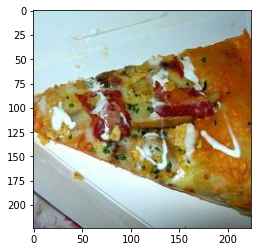

In [ ]:
mini_data = train_dataset.get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)

['48', '692', '942', '212', '471']


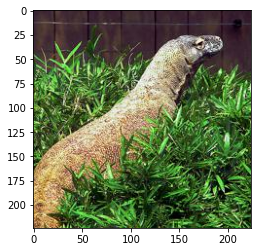

In [ ]:
mini_data,test_images,test_labels = train_dataset.get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes,split = True)

In [ ]:
test_labels[2]

2

In [ ]:
for image,label in mini_data:
  print(image.shape,label.shape)
  print(label[0])

(25, 224, 224, 3) (25,)
tf.Tensor(2, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(3, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(3, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(4, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(2, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(4, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int64)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int64)


In [ ]:
mini_data = train_dataset.get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)

In [ ]:
for image,label in mini_data:
  print(image.shape,label.shape)
  #plt.imshow(image[1])
  #plt.show()
  print(label[1])

(25, 224, 224, 3) (25,)
tf.Tensor(4, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(4, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(4, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(3, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(2, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(1, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(2, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(4, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(0, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(2, shape=(), dtype=int32)
(25, 224, 224, 3) (25,)
tf.Tensor(2, shape=(), dtype=int32)


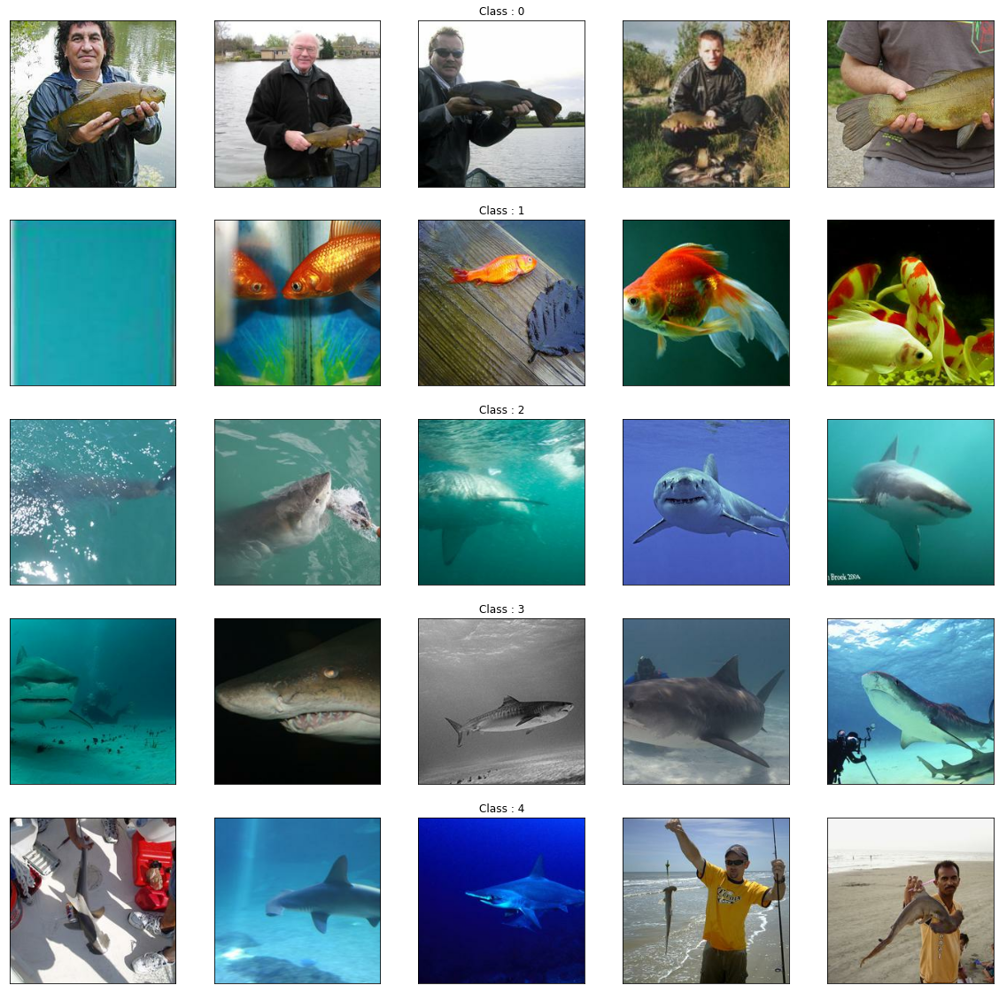

In [ ]:
_, axarr = plt.subplots(nrows=5, ncols=5, figsize=(20, 20))

sample_keys = list(train_dataset.data.keys())

for a in range(5):
    for b in range(5):
        temp_image = train_dataset.data[sample_keys[a]][b]
        if b == 2:
            axarr[a, b].set_title("Class : " + sample_keys[a])
        axarr[a, b].imshow(temp_image)
        axarr[a, b].xaxis.set_visible(False)
        axarr[a, b].yaxis.set_visible(False)
plt.show()

## Creating the model

In [ ]:
def conv_bn(x):
    x = layers.Conv2D(filters=64, kernel_size=3, strides=2, padding="same")(x)
    x = layers.BatchNormalization()(x)
    return layers.ReLU()(x)


inputs = layers.Input(shape=(28, 28, 1))
x = conv_bn(inputs)
x = conv_bn(x)
x = conv_bn(x)
x = conv_bn(x)
x = layers.Flatten()(x)
outputs = layers.Dense(classes, activation="softmax")(x)
model = keras.Model(inputs=inputs, outputs=outputs)
model.compile()
optimizer = keras.optimizers.SGD(learning_rate=learning_rate)


In [ ]:
!pip install tensorflow_addons
import tensorflow_addons as tfa
model = tf.keras.models.load_model("/content/drive/MyDrive/adv1/model_final.h5") #best model

     |████████████████████████████████| 1.1 MB 4.1 MB/s 


In [ ]:
input_shape = (224,224,3)
input = tf.keras.Input(shape=input_shape)
x = tf.keras.layers.Rescaling(1.0 / 255)(input)
x = tf.keras.layers.Normalization(mean=[0.485, 0.456, 0.406], variance=[0.229**2, 0.224**2, 0.225**2])(x)
m = tf.keras.applications.ResNet50(include_top = True, weights=None, input_shape=input_shape, classes=classes)(x)
#output = tf.keras.layers.Dense(5,activation = 'softmax')(m)
model = tf.keras.Model(input,m)
model.summary()
model.compile()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 normalization (Normalizatio  (None, 224, 224, 3)      0         
 n)                                                              
                                                                 
 resnet50 (Functional)       (None, 5)                 23597957  
                                                                 
Total params: 23,597,957
Trainable params: 23,544,837
Non-trainable params: 53,120
_________________________________________________________________


In [ ]:
optimizer = keras.optimizers.SGD(learning_rate=learning_rate)

## Pretrained model

In [ ]:
!pip install tensorflow_addons
import tensorflow_addons as tfa
model = tf.keras.models.load_model("/content/drive/MyDrive/adv1/model_best.h5")
print(model.summary())

In [ ]:
layer_name = "avg_pool"
model2 = tf.keras.Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
model2.summary()

In [ ]:
input_shape = (224,224,3)
sd = 0.1
inputs = tf.keras.Input(shape=input_shape)
x = tf.keras.layers.Rescaling(1.0 / 255)(inputs)
x = tf.keras.layers.Normalization(mean=[0.485, 0.456, 0.406], variance=[0.229**2, 0.224**2, 0.225**2])(x)
x = model2(x)
output = tf.keras.layers.Dense(units = classes,activation = 'softmax')

## Training the model

In [ ]:
learning_rate = 0.003
meta_step_size = 0.25

inner_batch_size = 25
eval_batch_size = 25

meta_iters = 2000
eval_iters = 5
inner_iters = 4

eval_interval = 1
train_shots = 20
shots = 5
classes = 5

In [ ]:
training = []
testing = []
for meta_iter in range(meta_iters):
    frac_done = meta_iter / meta_iters
    cur_meta_step_size = (1 - frac_done) * meta_step_size
    # Temporarily save the weights from the model.
    old_vars = model.get_weights()
    # Get a sample from the full dataset.
    mini_dataset = train_dataset.get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)
    #mini_dataset = get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)
    for images, labels in mini_dataset:
        with tf.GradientTape() as tape:
            preds = model(images)
            #print(preds.shape)
            #print(tf.math.argmax(preds,axis = 1))
            loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
            #print(loss)
        grads = tape.gradient(loss, model.trainable_weights)
        optimizer.apply_gradients(zip(grads, model.trainable_weights))
    new_vars = model.get_weights()
    # Perform SGD for the meta step.
    for var in range(len(new_vars)):
        new_vars[var] = old_vars[var] + (
            (new_vars[var] - old_vars[var]) * cur_meta_step_size
        )
    # After the meta-learning step, reload the newly-trained weights into the model.
    model.set_weights(new_vars)
    # Evaluation loop
    if meta_iter % eval_interval == 0:
        accuracies = []
        for dataset in [train_dataset]:
            # Sample a mini dataset from the full dataset.
            train_set, test_images, test_labels = dataset.get_mini_dataset(
                eval_batch_size, eval_iters, shots, classes, split=True
            )
            old_vars = model.get_weights()
            # Train on the samples and get the resulting accuracies.
            for images, labels in train_set:
                with tf.GradientTape() as tape:
                    preds = model(images)
                    loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
                grads = tape.gradient(loss, model.trainable_weights)
                optimizer.apply_gradients(zip(grads, model.trainable_weights))
            test_preds = model.predict(test_images)
            test_preds = tf.argmax(test_preds).numpy()
            num_correct = (test_preds == test_labels).sum()
            #print(num_correct)
            # Reset the weights after getting the evaluation accuracies.
            model.set_weights(old_vars)
            accuracies.append(num_correct / classes)
        training.append(accuracies)
        #testing.append(accuracies[1])
        if meta_iter % 100 == 0:
            print(
                "batch %d: train=%f" % (meta_iter, accuracies[0])
            )

batch 0: train=0.600000
batch 100: train=0.200000
batch 200: train=0.200000
batch 300: train=0.600000
batch 400: train=0.400000
batch 500: train=0.600000
batch 600: train=0.200000
batch 700: train=0.400000
batch 800: train=0.600000
batch 900: train=0.200000
batch 1000: train=0.200000
batch 1100: train=0.600000
batch 1200: train=0.200000
batch 1300: train=0.400000
batch 1400: train=0.000000
batch 1500: train=0.800000
batch 1600: train=1.000000
batch 1700: train=0.400000
batch 1800: train=0.400000
batch 1900: train=0.200000


In [ ]:
model.save("/content/drive/MyDrive/adv1/reptile")

INFO:tensorflow:Assets written to: /content/drive/MyDrive/adv1/reptile/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/adv1/reptile/assets


In [ ]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 normalization (Normalizatio  (None, 224, 224, 3)      0         
 n)                                                              
                                                                 
 resnet50 (Functional)       (None, 5)                 23597957  
                                                                 
Total params: 23,597,957
Trainable params: 23,544,837
Non-trainable params: 53,120
_________________________________________________________________


In [ ]:
training = []
testing = []
for meta_iter in range(meta_iters):
    frac_done = meta_iter / meta_iters
    cur_meta_step_size = (1 - frac_done) * meta_step_size
    # Temporarily save the weights from the model.
    old_vars = model.get_weights()
    # Get a sample from the full dataset.
    mini_dataset = train_dataset.get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)
    #mini_dataset = get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)
    for images, labels in mini_dataset:
        with tf.GradientTape() as tape:
            preds = model(images)
            #print(preds.shape)
            #print(tf.math.argmax(preds,axis = 1))
            loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
            #print(loss)
        grads = tape.gradient(loss, model.trainable_weights)
        optimizer.apply_gradients(zip(grads, model.trainable_weights))
    new_vars = model.get_weights()
    # Perform SGD for the meta step.
    for var in range(len(new_vars)):
        new_vars[var] = old_vars[var] + (
            (new_vars[var] - old_vars[var]) * cur_meta_step_size
        )
    # After the meta-learning step, reload the newly-trained weights into the model.
    model.set_weights(new_vars)
    # Evaluation loop
    if meta_iter % eval_interval == 0:
        accuracies = []
        for dataset in [train_dataset]:
            # Sample a mini dataset from the full dataset.
            train_set, test_images, test_labels = dataset.get_mini_dataset(
                eval_batch_size, eval_iters, shots, classes, split=True
            )
            old_vars = model.get_weights()
            # Train on the samples and get the resulting accuracies.
            for images, labels in train_set:
                with tf.GradientTape() as tape:
                    preds = model(images)
                    loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
                grads = tape.gradient(loss, model.trainable_weights)
                optimizer.apply_gradients(zip(grads, model.trainable_weights))
            test_preds = model.predict(test_images)
            test_preds = tf.argmax(test_preds).numpy()
            num_correct = (test_preds == test_labels).sum()
            #print(num_correct)
            # Reset the weights after getting the evaluation accuracies.
            model.set_weights(old_vars)
            accuracies.append(num_correct / classes)
        training.append(accuracies)
        #testing.append(accuracies[1])
        if meta_iter % 100 == 0:
            print(
                "batch %d: train=%f" % (meta_iter, accuracies[0])
            )

batch 0: train=0.600000
batch 100: train=0.400000
batch 200: train=0.600000
batch 300: train=0.600000
batch 400: train=0.200000
batch 500: train=0.600000
batch 600: train=0.000000
batch 700: train=0.200000
batch 800: train=1.000000
batch 900: train=0.600000
batch 1000: train=0.000000
batch 1100: train=1.000000
batch 1200: train=0.600000
batch 1300: train=0.200000
batch 1400: train=0.800000
batch 1500: train=0.200000


KeyboardInterrupt: ignored

In [ ]:
model.save("/content/drive/MyDrive/adv1/Reptile(new_param)")

INFO:tensorflow:Assets written to: /content/drive/MyDrive/adv1/Reptile(new_param)/assets


INFO:tensorflow:Assets written to: /content/drive/MyDrive/adv1/Reptile(new_param)/assets


# For testing

In [ ]:
model = tf.keras.models.load_model("/content/drive/MyDrive/adv1/reptile")

In [ ]:
from sklearn.metrics import accuracy_score
train_set, test_images, test_labels = dataset.get_mini_dataset(
    eval_batch_size, eval_iters, shots, classes, split=True
)
for images, labels in train_set:
    with tf.GradientTape() as tape:
        preds = model(images)
        loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
    grads = tape.gradient(loss, model.trainable_weights)
    optimizer.apply_gradients(zip(grads, model.trainable_weights))
test_preds = model.predict(test_images)
test_preds = tf.argmax(test_preds).numpy()
print(test_preds)
print(test_labels)
acc = accuracy_score(test_labels,test_preds)
print(acc)

[0 2 2 1 4]
[0 1 2 3 4]
0.6


labels =  [0 1 2 3 4]
predictions =  [0 2 2 1 4]


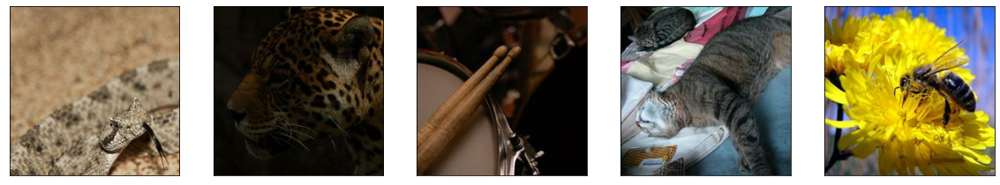

In [ ]:
_, axarr = plt.subplots(nrows=1, ncols=5, figsize=(20, 20))

sample_keys = test_labels.tolist()
print("labels = ",test_labels)
print("predictions = ",test_preds)
for a in range(1):
    for b in range(5):
        temp_image = test_images[b]#train_dataset.data[sample_keys[a]][b]
        axarr[b].imshow(temp_image)
        axarr[b].xaxis.set_visible(False)
        axarr[b].yaxis.set_visible(False)
plt.show()

In [ ]:
'''_, axarr = plt.subplots(nrows=1, ncols=5, figsize=(224, 224))

sample_keys = list(train_dataset.data.keys())

for i, ax in zip(range(5), axarr):
    temp_image = np.stack((test_images[i, :, :, 0],) * 3, axis=2)
    temp_image *= 255
    temp_image = np.clip(temp_image, 0, 255).astype("uint8")
    ax.set_title(
        "Label : {}, Prediction : {}".format(int(test_labels[i]), test_preds[i])
    )
    ax.imshow(temp_image)
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.show()'''

['738', '635', '947', '435', '694']


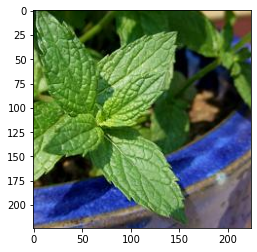

(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 2 3 3 3 2 3 3 3 3 3 3 3 2 3 3 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 1 4 4 4 4 4 1 4 4 4 1 4 4 1 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 1 4 3 4 4 1 3 2 3 1 3 4 1 2 1 3 2 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 2 3 3 3 3 3 3 3 3 3 3 2 3 3 3 3 3 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 3 4 4 4

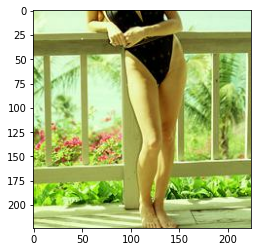

1
batch 0: train=0.200000
['786', '610', '596', '537', '959']


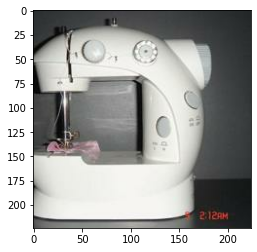

(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 1 4 2 1 1 3 1 4 3 1 2 0 1 1 0 1 1 2 0 4 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 0 0 3 0 0 0 0 0 0 3 0 0 0 3 0 0 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 0 0 0 0 4 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 2 0 0 0 0 3 0 0 0 3 0 0 0 0 3 3 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 0 0 4 0 1 0 4 1 0 1 1 4 1 1 1 4 1 4 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 0 0 1 1 4 0 4 0 0 0 4 0 4 0 0 4 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 2 2 2 2

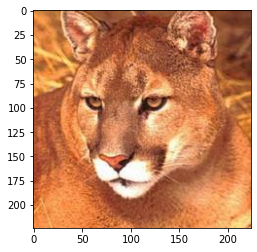

0
['798', '401', '127', '54', '883']


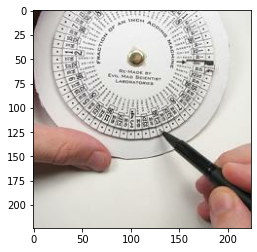

(25, 5)
tf.Tensor([1 1 1 4 0 1 2 1 0 1 2 1 1 1 1 1 1 1 4 1 1 1 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 4 4 4 4 4 1 4 1 4 4 4 4 4 4 4 4 4 4 4 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 4 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 0 0 1 1 0 1 0 0 0 1 1 1 0 0 1 1 0 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 3 3 3 1 3 3 3 3 3 3 3 3 1 3 3 1 3 3 1 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 3 1 1 2 3 3 1 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 4 1 4 1 1 1 1 1 1 1 1 1 4 1 4 4 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 2 1 1 1 1 1 3 1 1 1 1 1 3 1 1 2 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 1 0 3 3 3 3 3 3 1 1 1 1 3 3 3 1 1 3 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 3 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0

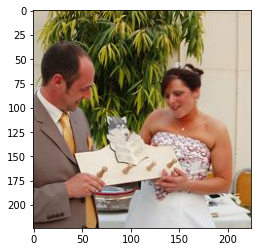

2
['350', '729', '752', '680', '553']


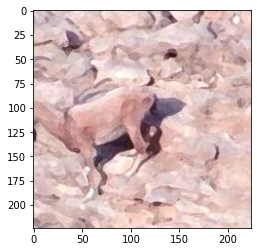

(25, 5)
tf.Tensor([0 3 0 3 3 3 3 3 3 3 0 3 3 3 3 3 3 3 0 3 3 3 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 4 4 3 4 4 4 4 3 3 3 4 3 4 4 3 3 3 4 3 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 4 4 4 1 4 4 4 4 4 1 1 4 4 4 1 4 4 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 2 2 2 2 2 2 2 1 1 2 2 1 2 1 1 2 2 2 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 3 3 3 3 3 0 3 3 0 3 0 3 3 3 3 3 0 3 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 3 4 3 3 3 3 4 3 3 3 3 3 3 3 3 3 3 3 3 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 3 2 2 2 2 2 2 2 2 2 2 3 3 2 2 2 3 3 3 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 0 0 0 1 4 1 1 1 0 1 0 0 1 0 1 1 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 3 0 3 3 3 0 3 3 3 3 3 0 3 0 0 3 3 3 3 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 2 1 2

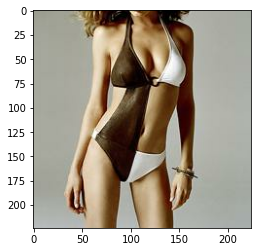

2
['937', '305', '308', '754', '537']


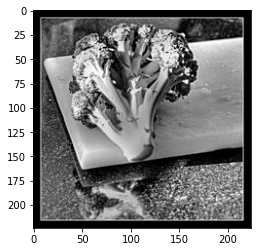

(25, 5)
tf.Tensor([3 3 0 3 0 3 0 0 0 3 4 0 3 0 0 3 0 3 3 3 0 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 2 2 2 1 1 1 2 2 1 1 1 1 2 2 1 2 1 1 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 3 3 3 3 4 0 4 4 4 3 4 4 3 4 3 4 3 0 4 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 3 3 1 1 1 1 1 1 3 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 2 2 2 2 0 2 0 1 2 0 1 0 2 2 1 2 2 2 2 0 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 4 4 4 0 4 4 4 4 4 4 4 4 0 4 0 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 4 4 3 4 3 4 3 3 0 4 4 4 3 0 0 4 4 0 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3

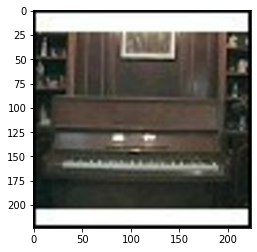

2
['829', '199', '600', '177', '113']


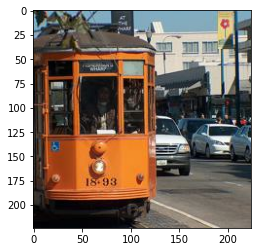

(25, 5)
tf.Tensor([3 3 3 3 3 0 3 3 0 3 0 3 0 3 3 3 0 3 0 3 3 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 2 3 2 3 2 2 2 3 2 3 3 3 2 2 2 3 3 2 2 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 3 2 3 4 4 2 4 4 4 4 4 4 4 2 4 4 4 4 3 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 0 0 0 3 0 0 0 0 0 0 0 3 0 0 3 0 3 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 4 4 1 4 0 1 4 1 1 1 0 1 4 1 3 3 0 1 0 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 0 2 0 0 2 2 0 2 0 0 0 0 0 2 0 2 0 2 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 0 2 2 0 2 2 0 0 0 0 2 0 0 0 0 0 2 2 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 2 0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 2 0 0 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 3 3 3

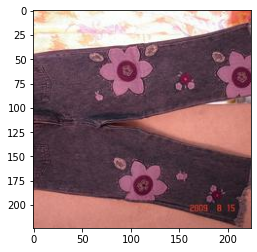

2
['988', '971', '362', '909', '750']


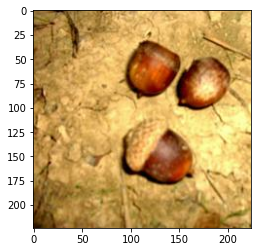

(25, 5)
tf.Tensor([0 3 0 3 3 3 0 0 0 4 0 2 3 0 3 4 0 0 0 3 3 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 3 3 3 3 3 0 3 0 0 3 3 3 3 0 3 0 3 3 3 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 3 0 0 3 0 3 3 3 3 0 0 3 3 3 3 3 0 3 3 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 2 2 2 3 0 3 0 3 2 0 3 3 2 0 2 0 0 0 3 2 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 2 4 4 4 4 2 4 1 2 4 2 4 2 4 2 2 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 3 0 0 3 0 0 0 3 4 0 0 3 0 0 4 3 3 3 0 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 1 4 2 2 2 4 4 2 4 2 2 2 4 2 4 4 4 2 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 4 2

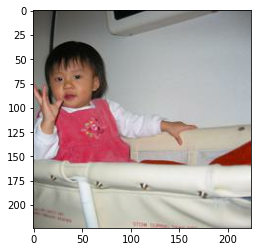

2
['958', '196', '262', '825', '975']


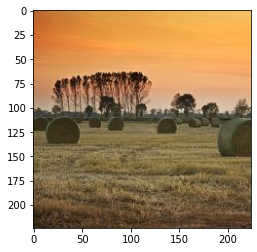

(25, 5)
tf.Tensor([4 3 0 0 3 4 4 4 3 3 4 4 4 4 3 3 0 0 4 3 3 3 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 1 1 1 1 1 1 1 4 4 1 4 1 1 1 1 4 1 4 1 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 4 4 4 4 4 4 4 2 4 4 4 4 4 4 4 2 0 0 4 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 1 3 4 3 4 4 4 4 1 4 4 4 1 4 4 4 4 2 4 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 0 0 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 0 3 0 3 0 0 3 0 0 0 3 0 0 3 3 0 0 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 0 0 0 1 0 0 0 0 1 0 0 0 1 1 0 1 1 1 1 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 3 3 3 3 0 0 0 3 0 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 4 3 4 3 4 3 4 4 3 3 3 2 3 4 3 4 3 3 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 4 4 4 4 4 4 4 4 4 0 4 4 4 4 4 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2

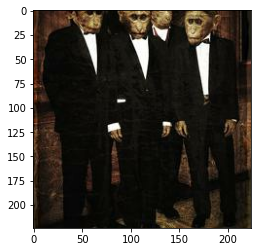

1
['110', '762', '832', '223', '259']


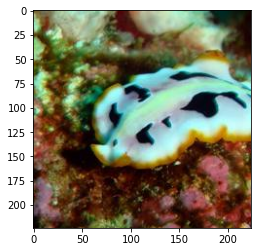

(25, 5)
tf.Tensor([2 3 2 2 2 2 2 2 3 3 2 2 3 2 2 3 2 3 2 3 2 2 3 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 2 2 1 2 2 2 1 2 2 2 2 2 1 2 2 2 2 2 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 1 0 1 1 1 1 2 2 2 1 2 2 0 2 1 2 1 2 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 2 0 0 2 2 0 0 0 0 0 2 0 2 0 0 0 2 0 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 2 0 0 0 2 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 2 0 0 0 0 0 4 3 0 2 3 2 0 4 0 2 0 2 0 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 4 3 2 2 1 2 4 2 2 4 0 1 0 2 3 3 3 0 4 4 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 3 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1

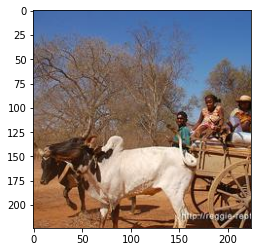

2
['549', '529', '146', '714', '380']


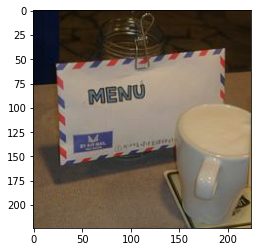

(25, 5)
tf.Tensor([0 3 2 0 2 2 2 2 3 0 2 3 3 3 2 2 3 0 2 2 0 3 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 1 1 0 1 0 0 1 1 1 1 1 1 1 0 0 1 0 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 4 4 2 4 2 1 2 2 2 4 2 4 2 4 4 2 1 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 4 0 4 0 0 0 0 0 0 0 0 0 0 0 4 4 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 0 0 0 0 0 3 3 0 0 0 3 0 3 0 0 0 0 0 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 1 1 1 0 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 4 2 2 2 4 4 2 4 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4

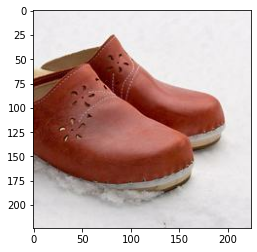

2
['727', '356', '351', '604', '289']


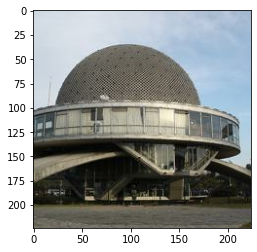

(25, 5)
tf.Tensor([0 0 0 2 2 2 3 0 2 2 0 2 0 0 2 2 2 0 2 2 2 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 3 0 0 3 0 3 3 3 0 0 3 0 0 0 0 0 0 3 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 2 0 3 3 0 3 3 3 3 3 0 3 3 3 0 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 0 0 0 3 1 0 0 0 0 0 0 0 0 1 3 0 3 2 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 4 0 4 4 0 4 4 0 0 4 4 0 4 4 4 0 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 3 0 3 4 0 4 0 3 3 0 0 4 0 3 3 3 4 0 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 0 4 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 0 3 0 4 0 4 4 4 4 1 3 3 4 3 1 0 0 4 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 4 2 2 2 2 2 2 0 2 2 2 4 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 3 2 2

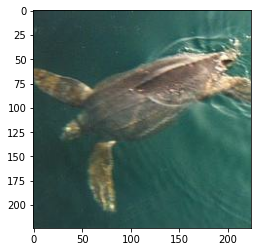

1
['802', '527', '300', '358', '607']


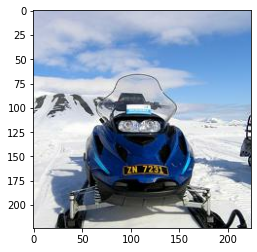

(25, 5)
tf.Tensor([0 0 3 0 0 0 0 0 0 2 0 0 2 2 0 0 3 2 0 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 3 4 3 3 4 3 4 4 4 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 2 2 2 4 2 2 2 2 2 2 2 2 4 4 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 2 2 4 2 2 2 2 4 4 2 2 2 2 2 4 2 4 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 0 0 0 0 0 0 0 0 0 0 0 4 0 0 0 0 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 4 0 4 0 0 0 4 4 0 0 0 0 4 0 4 0 4 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 0 4 4 4 4 4 0 4 0 0 4 4 4 4 0 4 0 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 0 4 4 0 0 4 0 4 0 1 4 0 0 0 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 0 0 4 4 4 4 0 4 0 4 4 0 1 0 1 0 0 0 0 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 1 4 4 1 1 1 1 1 1 4 1 4 1 1 4 1 1 1 1 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 4 4 4

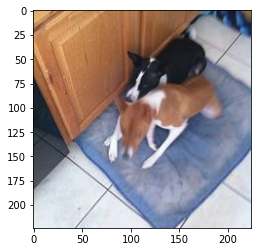

2
['672', '875', '440', '17', '346']


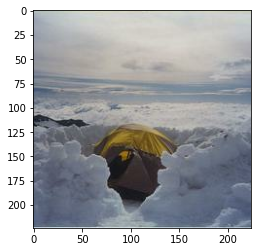

(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 1 2 2 2 3 2 2 2 2 2 2 1 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 4 3 3 3 3 3 3 3 0 3 3 3 0 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 2 1 1 4 1 4 4 1 1 1 1 1 1 1 1 1 1 1 1 1 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 0 1 1 0 4 1 0 1 1 4 2 0 4 0 0 1 0 1 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 2 2 4 2 4 2 4 2 2 2 2 2 2 4 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 2 2 2 2 2 3 2 2 2 3 2 2 2 3 2 3 2 2 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 4 1 4 4 1 4 1 1 3 0 1 4 4 4 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 3 3 4 1 0 2 2 2 4 4 2 4 4 1 2 4 2 4 2 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 2 2 2

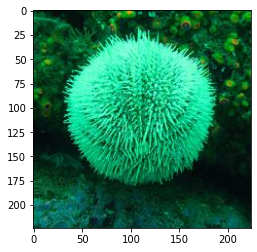

2
['485', '533', '733', '770', '26']


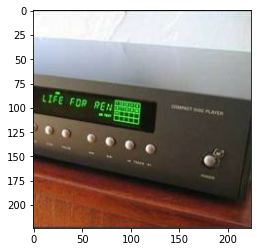

(25, 5)
tf.Tensor([3 4 2 2 4 3 4 2 4 4 2 2 4 2 4 2 3 4 3 2 2 4 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 4 2 2 2 2 2 4 2 2 2 2 2 2 4 2 2 4 2 2 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 4 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 2 4 2 2 2 2 4 2 2 4 2 2 4 2 1 2 2 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 4 3 4 1 3 3 1 4 1 3 3 3 3 4 3 4 1 4 4 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 2 2 2 2 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 3 4 3 3 3 4 3 4 3 3 4 4 4 4 3 3 3 3 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 3 3 4 4 1 4 4 4 4 3 1 4 3 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 4 3 3 4 4 4 4 3 3 4 4 4 1 3 3 3 4 4 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 2 3 3 3 4 4 3 3 4 2 4 4 4 4 2 3 4 4 4 4 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 1 2

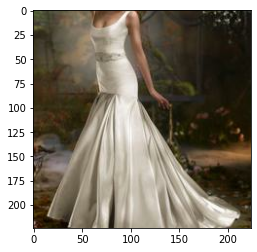

3
['891', '539', '993', '793', '747']


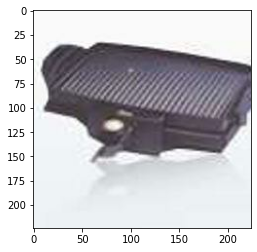

(25, 5)
tf.Tensor([2 4 1 2 4 1 2 2 4 4 4 1 1 3 2 1 4 4 1 2 2 1 1 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 4 4 0 4 4 4 4 1 4 4 4 4 4 0 4 4 1 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 0 1 1 4 0 0 1 0 0 1 0 0 0 1 0 0 1 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 2 2 2 4 2 4 2 2 0 2 2 2 2 2 2 2 2 4 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 3 3 4 3 4 4 3 4 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 2 4 2 4 2 2 4 2 4 2 4 0 4 0 2 2 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 0 4 3 0 4 2 2 2 4 4 2 2 0 0 2 0 2 2 4 0 4 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 0 0 2 2 2 0 4 2 2 2 4 2 4 2 2 2 2 2 0 0 0 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 4 0

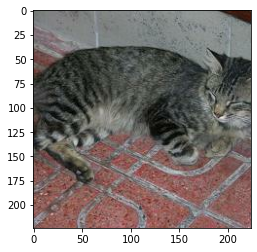

2
['596', '917', '555', '712', '82']


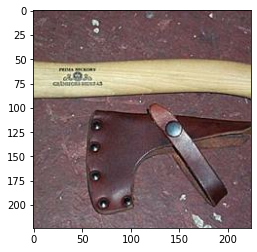

(25, 5)
tf.Tensor([1 3 4 4 1 4 4 0 4 4 4 4 4 4 1 1 1 3 1 0 4 1 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 2 2 1 2 4 2 2 0 0 2 0 0 2 0 1 2 2 2 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 3 4 3 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 1 4 1 3 1 4 1 1 1 1 4 3 1 1 4 1 1 1 3 1 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 4 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 1 1 2 1 2 1 1 1 1 4 1 1 4 4 4 4 1 1 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 4 3 4 3 3 3 3 3 3 3 1 1 3 3 4 3 4 4 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 4 4 4 3 3 3 3 4 3 3 4 4 4 4 4 3 3 1 0 1 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 2 4 2 2 2 2 2 2 2 2 2 4 1 2 4 1 2 4 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 4 2 4

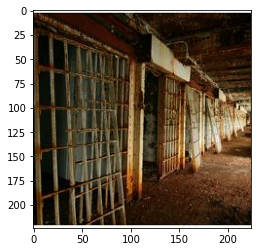

1
['585', '347', '466', '658', '217']


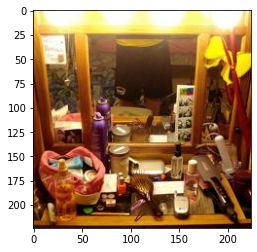

(25, 5)
tf.Tensor([4 4 4 4 3 2 4 4 2 4 2 2 2 4 2 2 4 2 2 2 4 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 4 3 3 3 3 3 3 4 3 4 3 4 3 3 3 3 3 3 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 4 4 4 3 2 2 4 4 2 3 4 2 4 2 4 2 2 2 4 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 3 3 3 3 4 4 4 4 3 3 3 4 3 3 3 4 4 4 4 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 4 4 4 4 0 0 4 0 0 0 1 4 0 4 4 4 4 4 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 3 3 0 0 0 0 3 0 3 3 3 4 3 3 3 4 3 3 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 4 3 4 4 4 3 3 0 3 0 3 3 3 4 4 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 4 4 4 4 3 4 4 4 4 3 4 3 4 4 4 0 4 3 0 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 2 0 2 2 0 2 2 2 4 2 0 0 0 4 0 0 0 0 0 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 0 0 0 2 0 2 2 0 0 2 0 0 0 2 2 2 0 0 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 4 4 4

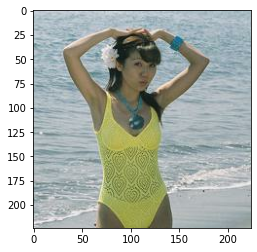

0
['650', '4', '113', '176', '30']


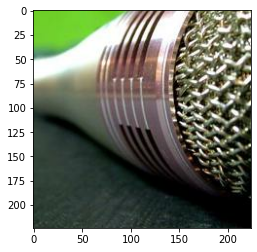

(25, 5)
tf.Tensor([4 4 4 4 4 4 2 4 4 4 4 4 4 4 4 2 2 4 2 4 2 2 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 2 2 2 3 4 3 3 4 4 4 4 3 4 3 3 3 4 4 3 3 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 4 0 0 4 0 4 0 1 1 4 0 4 4 0 0 4 4 4 1 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 4 4 1 1 4 4 4 4 1 4 1 4 4 1 4 4 1 1 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 4 2 4 1 0 2 4 2 2 2 2 4 1 1 2 0 2 1 1 0 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 2 1 4 1 4 4 4 1 4 4 4 4 1 4 1 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 4 1 0 1 1 1 0 0 4 1 4 4 4 0 4 4 0 1 4 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 0 0 0 0 2 1 1 4 0 4 4 4 2 0 0 0 0 4 0 0 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 4 4 4 1 1 2 1 1 1 1 1 1 4 1 1 1 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 0 0 0 4 0 4 1 0 4 0 4 4 4 0 4 0 0 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 4 4 4

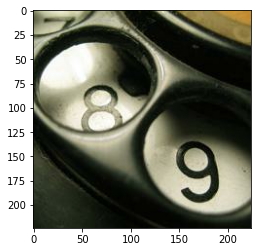

1
['154', '914', '394', '446', '963']


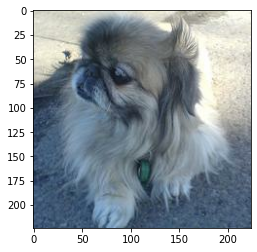

(25, 5)
tf.Tensor([4 3 0 2 4 3 4 4 2 3 4 2 4 3 4 0 4 4 0 2 4 2 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 4 0 0 4 0 1 0 4 0 0 0 4 0 0 4 0 0 0 4 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 1 1 4 1 4 2 2 4 4 4 1 2 1 1 1 2 4 2 2 1 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 4 4 1 1 4 4 4 1 1 1 4 1 4 1 1 1 4 4 1 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 3 1 3 4 3 3 4 3 3 3 4 1 4 3 4 3 3 1 1 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 4 2 2 2 2 2 4 2 2 2 2 4 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 4 4 0 4 1 4 4 4 4 4 1 4 4 4 1 1 1 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 1 1 4 1 1 1 1 1 4 4 1 4 4 1 4 1 4 4 4 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 3 1 1 1 4 1 1 1 4 4 4 4 3 3 4 3 4 1 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 4 1 4 1 1 4 1 3 1 3 1 4 3 4 1 4 4 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1

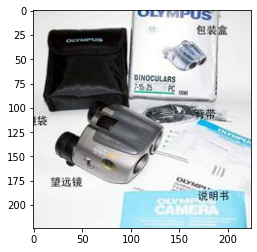

1
['35', '128', '878', '479', '870']


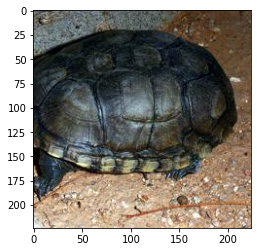

(25, 5)
tf.Tensor([4 2 4 4 4 4 2 2 4 4 2 2 4 4 2 4 4 3 4 4 4 4 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 2 4 4 4 2 4 4 0 4 2 0 4 4 4 4 4 4 4 4 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 2 4 4 4 4 4 2 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 4 3 4 3 3 3 3 3 3 3 3 3 4 3 3 4 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 4 2 4 3 2 3 3 3 3 4 4 3 2 4 3 3 2 2 2 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 2 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 1 2 4 4 4 2 4 4 4 4 4 4 4 2 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 3 3 4 4 4 4 4 4 3 4 4 3 3 4 4 4 3 4 3 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 3 2 3 0 3 3 0 4 0 3 4 3 2 0 3 3 3 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 4 2 4 2 4 3 2 2 2 3 2 4 2 3 2 2 4 2 2 2 3 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 3

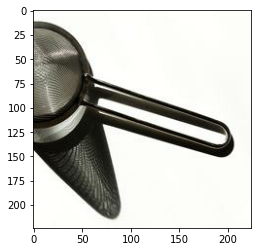

4
['187', '723', '854', '507', '48']


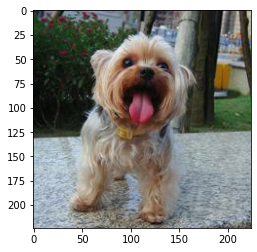

(25, 5)
tf.Tensor([4 2 4 4 2 3 2 4 4 2 4 4 2 2 4 4 4 4 2 3 4 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 3 4 4 3 3 3 3 3 3 4 3 4 3 4 3 3 3 3 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 2 2 2 2 2 3 2 4 2 2 2 2 2 2 2 2 3 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 4 2 3 2 2 2 2 2 2 2 2 2 2 4 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 2 4 2 4 2 2 2 4 2 2 2 2 2 2 4 2 2 4 4 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 3 2 2 2 2 0 3 3 3 0 3 3 2 3 2 2 2 3 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 2 3 3 3 3 3 3 3 2 3 2 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 1 4 4 0 4 3 0 2 2 2 3 3 3 4 2 4 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 3 2 3 3 3 3 3 3 3 3 3 3 3 3 3 3 2 3 3 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 2 4 2 0

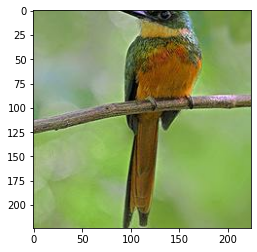

3
['941', '325', '931', '629', '424']


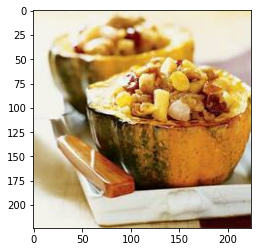

(25, 5)
tf.Tensor([3 4 4 4 4 4 0 4 4 0 4 4 4 4 4 4 4 3 3 4 0 4 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 0 0 0 0 0 0 0 0 0 0 3 0 0 3 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 0 0 4 0 0 4 0 4 0 0 0 4 0 0 2 0 0 0 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 4 2 4 2 4 4 2 4 2 4 4 4 2 4 2 4 2 4 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 0 4 0 0 3 0 3 3 0 3 3 0 0 0 3 3 3 0 4 0 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 0 3 2 0 2 3 3 2 0 3 4 2 0 0 3 2 0 3 0 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 3 4 0 0 0 0 4 1 4 3 3 0 0 0 4 4 4 0 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 1 3 1 4 4 0 0 0 0 4 0 0 0 0 4 1 0 0 1 1 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 3 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 3 3 2 2 3 3 3 3 4 0 2 3 3 3 3 0 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 2 2 2

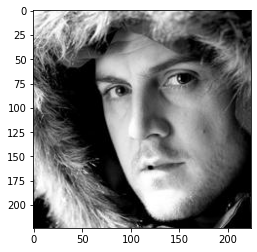

0
['418', '479', '23', '999', '774']


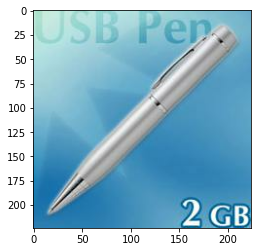

(25, 5)
tf.Tensor([4 3 4 3 4 3 3 3 4 3 4 3 4 4 4 4 3 4 4 0 4 4 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 3 3 4 3 4 3 3 4 3 3 3 3 3 3 3 3 4 3 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 4 4 4 2 4 4 2 2 2 4 4 2 2 4 4 2 4 2 4 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 2 4 4 4 4 0 4 2 2 2 0 2 2 2 0 4 4 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 2 4 4 4 4 4 2 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 4 1 4 4 2 1 4 4 4 3 3 4 3 4 4 4 4 4 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 2 1 4 2 1 1 1 0 4 2 1 1 1 4 1 1 1 2 1 3 1 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 4 4 2 2 4 2 1 4 4 2 2 2 1 2 2 2 1 4 4 4 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 2 0 4 0 0 0 0 4 4 0 4 4 0 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 2 0 0 0 0 2 0 0 0 0 0 0 0 1 0 2 0 2 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 2 0 2 4

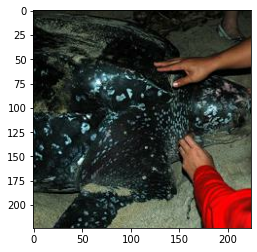

1
['590', '111', '321', '536', '797']


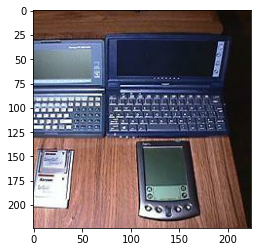

(25, 5)
tf.Tensor([2 4 0 3 3 4 2 4 3 3 2 3 4 2 2 3 4 3 2 0 4 3 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 4 4 4 4 3 3 4 4 3 4 3 3 3 4 4 4 3 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 3 2 2 2 3 4 2 3 2 3 2 3 0 3 2 4 3 3 3 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 4 3 4 3 4 3 4 1 4 3 1 4 3 4 4 3 4 1 4 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 3 4 3 3 4 4 4 1 4 4 4 3 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 3 3 3 4 3 3 3 3 3 3 3 3 3 4 4 4 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 2 3 1 3 3 3 2 3 3 1 4 4 3 1 3 4 1 3 2 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 4 1 4 3 4 0 4 4 4 3 4 4 0 4 0 4 1 4 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 4 3 0 0 3 2 1 0 0 0 3 3 3 4 1 1 2 4 4 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 4 4 1 1 0 4 4 4 0 4 4 0 1 4 4 4 4 4 0 1 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 0 0 3

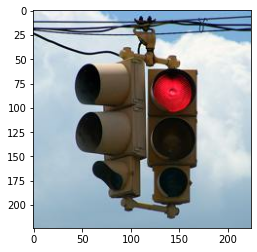

3
['522', '180', '615', '390', '121']


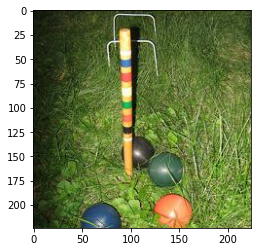

(25, 5)
tf.Tensor([3 3 3 4 3 4 3 3 3 4 3 3 3 4 4 3 4 4 2 4 4 3 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 4 4 0 3 4 0 1 3 3 4 3 3 4 4 4 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 2 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 2 4 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 4 1 2 2 2 1 4 2 2 2 2 1 2 2 2 2 2 4 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 4 2 2 2 2 1 2 1 2 2 4 2 4 2 2 4 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 2 2 2 2 4 2 2 4 4 4 2 2 2 2 2 2 2 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 3 4 4 2 4 3 3 3 1 2 4 4 4 4 4 4 1 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 3 3 3 4 4 3 3 3 4 3 4 3 4 3 3 4 4 4 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 4 2 2

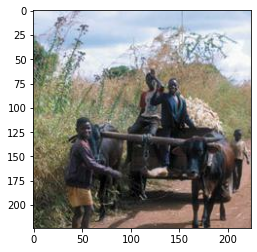

3
['525', '841', '62', '927', '951']


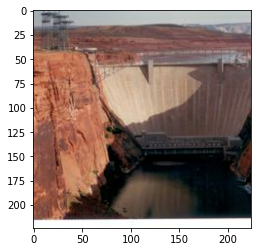

(25, 5)
tf.Tensor([4 4 4 3 3 4 3 4 4 4 4 4 4 4 4 4 3 4 3 4 4 4 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 4 0 4 4 4 0 0 4 0 0 0 4 0 4 0 4 0 0 0 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 3 4 4 4 4 3 4 4 4 4 4 4 4 3 4 3 4 3 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 4 4 4 4 3 4 4 3 4 4 4 4 4 4 3 3 4 3 3 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 1 1 3 1 3 3 4 4 3 4 4 4 3 4 3 4 4 4 3 1 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 3 3 3 3 3 4 1 4 4 3 1 3 3 3 3 4 3 4 1 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 1 4 4 4 1 4 1 4 1 4 4 1 4 4 1 1 4 1 3 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 4 4 1 4 4 1 4 4 4 4 1 4 1 4 1 1 4 1 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 1 1 1 1 1 1 1 4 3 4 1 3 0 3 1 3 4 1 3 3 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 3 4 3 0 3 3 4 1 0 1 4 1 1 1 1 1 1 1 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 3 4 3

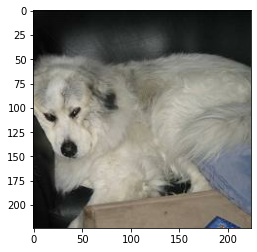

0
['676', '93', '433', '541', '62']


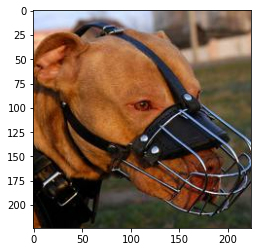

(25, 5)
tf.Tensor([4 3 3 3 4 3 4 4 3 4 3 3 3 3 3 3 4 3 3 3 3 4 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 4 2 3 3 4 3 3 4 3 3 3 3 3 3 2 2 3 3 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 4 3 4 1 4 1 3 1 3 4 3 4 4 3 3 1 4 3 3 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 2 0 4 4 3 4 3 4 3 0 4 3 4 4 4 4 2 4 2 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 4 2 2 2 4 2 2 4 2 2 2 2 4 0 1 2 0 2 2 3 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 3 3 4 3 2 2 3 2 2 2 2 2 1 2 2 2 2 2 3 4 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 4 2 2 2 2 3 2 2 2 2 2 4 4 2 2 2 2 3 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 0 4 4 4 4 4 4 0 0 4 4 4 0 0 4 3 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 0 0 3 2 0 0 3 4 4 2 0 3 0 3 1 2 1 3 4 2 3 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 0 0 0 0 0 0 0 0 0 3 0 3 0 0 0 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 4 2

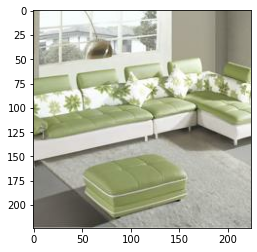

2
['708', '146', '528', '317', '914']


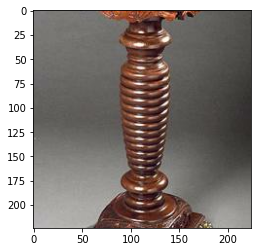

(25, 5)
tf.Tensor([4 3 4 4 3 3 0 0 0 4 3 4 3 3 4 3 3 3 4 3 3 3 3 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 2 4 4 4 1 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 2 3 3 2 2 2 3 3 3 2 2 1 1 3 3 3 2 1 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 3 2 0 3 3 3 3 3 3 3 4 3 3 3 3 0 3 3 3 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 0 0 3 0 0 0 3 0 0 3 3 3 0 3 3 0 3 3 3 0 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 2 3 2 3 3 2 3 2 2 2 3 2 3 2 2 2 3 2 2 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 2 2 2 2 2 2 2 4 4 4 2 2 2 2 2 4 4 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 4 0 2 1 2 4 4 4 0 4 4 2 4 4 4 2 2 1 4 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 4 3 4 3

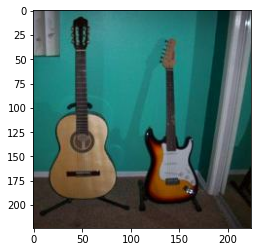

4
['626', '234', '346', '27', '341']


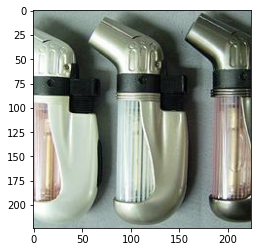

(25, 5)
tf.Tensor([4 4 3 4 3 4 4 3 4 4 3 3 4 4 4 4 3 3 4 3 3 4 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 3 3 3 3 3 3 3 3 3 4 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 0 3 0 3 3 0 0 0 3 0 0 3 0 0 3 0 0 3 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 0 0 0 0 3 4 0 0 4 0 4 4 0 0 4 0 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 4 3 3 4 3 0 3 4 0 3 0 0 0 4 0 4 4 3 4 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 0 0 3 1 0 0 3 1 0 0 3 1 0 3 1 0 0 0 3 3 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 4 4 4 1 4 3 4 4 0 4 4 4 0 4 4 4 3 4 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 0 0 0 0 3 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 3 0 1 0 3 1 0 1 3 3 0 0 2 3 3 0 3 1 1 0 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 3 0

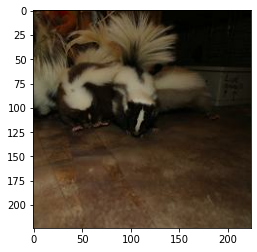

3
['662', '467', '995', '903', '860']


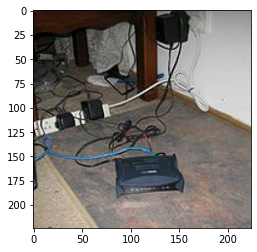

(25, 5)
tf.Tensor([4 4 4 3 4 4 4 3 4 3 4 3 3 4 0 4 4 4 0 4 4 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 3 0 0 4 0 4 3 4 4 4 3 4 3 0 3 3 3 0 3 0 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 1 4 4 4 4 4 0 4 0 4 4 4 0 0 3 4 4 4 4 4 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 0 0 4 3 0 1 1 1 1 1 1 0 1 1 1 1 3 1 3 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 4 1 1 1 0 0 1 0 1 1 1 0 1 1 1 1 0 1 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 3 1 1 1 0 1 1 1 0 3 1 1 3 1 0 1 3 0 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 4 4 4 0 0 0 0 1 3 4 3 0 0 4 0 4 0 3 0 0 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 1 1 2 4 1 1 1 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 0 1 1 0 1 0 1 1 0 1 4 1 0 1 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 1 1

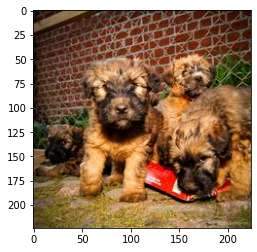

0
['160', '436', '288', '159', '816']


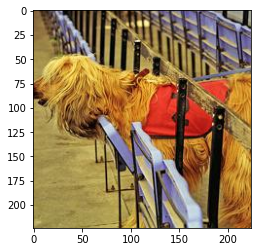

(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 0 4 4 4 4 4 4 4 4 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 3 0 0 4 4 0 4 4 0 0 4 4 4 0 3 3 4 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 4 4 0 4 4 3 4 0 4 0 0 0 4 3 0 4 3 3 0 0 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 0 0 2 4 3 4 4 1 3 2 3 3 4 2 3 3 4 0 3 3 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 3 0 0 0 3 0 0 0 3 0 0 0 0 3 3 0 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 0 4 0 4 3 3 4 2 0 0 3 3 0 3 4 0 3 3 0 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 1 3 3 3 3 3 3 4 3 3 4 4 3 3 4 1 3 4 3 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 2 1 1 2 1 2 1 4 1 2 2 1 2 1 2 1 1 2 1 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 2 1 1 3 2 1 1 1 4 1 2 1 1 2 1 1 1 2 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 2 2 4

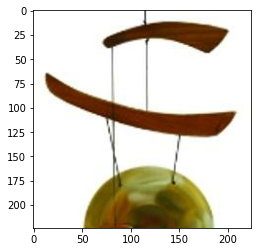

2
['91', '287', '718', '911', '428']


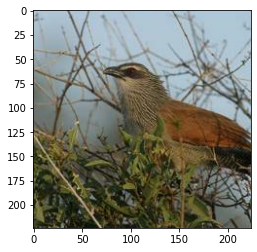

(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 0 4 4 4 4 4 4 4 4 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 4 4 4 4 4 4 0 4 4 0 4 4 4 4 4 4 4 0 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 2 2 4 4 4 4 4 2 4 4 4 4 4 0 4 0 4 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 4 4 4 2 4 2 4 4 0 2 2 2 2 4 2 2 2 4 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 4 2 4 4 2 3 4 2 2 2 4 2 4 3 2 4 4 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 4 4 2 3 4 2 2 3 4 2 3 3 3 3 2 4 2 3 3 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 4 2 4 4 2 3 4 1 2 3 4 1 4 2 2 1 1 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 1 2 2 4 2 2 4 2 3 2 3 2 3 0 4 2 2 4 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 2 4 2 2 2 0 2 2 2 2 2 4 4 0 4 2 2 4 4 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 0 2 3 2 0 4 4 4 2 4 4 4 3 4 4 0 0 0 4 0 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 4 2

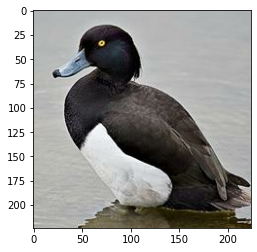

2
['252', '287', '960', '929', '354']


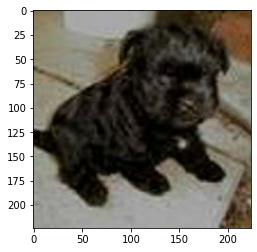

(25, 5)
tf.Tensor([3 4 4 4 4 4 4 4 4 3 4 4 3 4 3 3 4 4 4 3 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 3 4 4 4 4 4 4 3 4 4 3 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 3 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 0 4 4 3 4 4 4 3 4 0 3 3 4 4 3 4 3 4 4 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 2 0 2 2 0 0 0 0 2 2 2 2 2 4 2 2 3 2 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 2 2 3 2 2 2 2 2 3 3 3 2 2 2 2 2 2 2 2 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 0 0 0 0 2 0 2 2 2 0 2 2 0 0 2 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 0 4 4 4 4 4 4 4 4 0 0 4 4 4 0 4 4 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 0 4 4 0 1 4 1 4 3 4 1 1 4 0 4 4 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 2 0 1 2 1 4 4 0 2 2 1 1 4 4 1 1 2 1 3 2 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 1 2 0

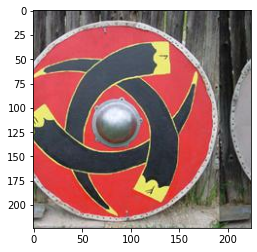

0
['118', '243', '999', '62', '431']


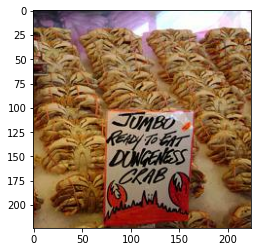

(25, 5)
tf.Tensor([4 4 4 4 3 0 4 4 4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 4 0 0 0 4 4 0 0 4 4 0 4 4 4 0 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 2 4 2 4 1 0 0 1 4 2 1 4 0 1 4 4 4 4 0 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 2 2 2 0 1 0 0 1 2 0 1 2 4 0 0 0 2 1 0 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 1 2 2 3 2 2 0 2 1 2 3 2 3 4 2 2 2 3 1 1 0 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 2 2 0 0 2 2 0 0 0 2 0 2 1 4 4 0 0 0 2 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 4 0 4 4 0 4 0 0 0 0 4 4 0 0 2 4 0 4 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 0 0 2 2 0 1 2 1 2 0 2 0 2 0 0 2 2 4 2 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 0 4 0 4 4 0 0 0 4 4 0 0 4 0 4 4 0 0 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 0 0

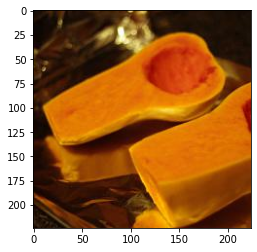

2
['370', '727', '984', '974', '861']


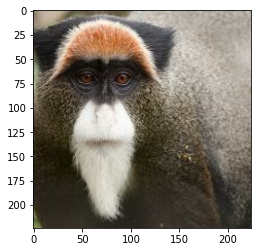

(25, 5)
tf.Tensor([4 4 2 4 4 4 3 4 4 3 4 4 4 4 4 2 4 3 2 4 4 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 1 1 2 1 2 2 1 2 1 2 1 2 2 2 2 1 2 1 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 1 2 2 1 1 1 1 1 1 2 1 1 1 1 2 1 2 2 1 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 1 1 1 3 3 2 1 2 2 4 2 3 1 1 3 1 1 3 3 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 4 3 4 3 4 1 3 2 3 3 2 2 2 2 2 2 2 3 3 3 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 4 1 1 3 1 1 2 2 1 1 1 1 1 2 1 1 1 1 2 1 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 2 4 1 1 1 2 2 1 1 2 1 2 4 1 1 1 1 1 1 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 4 3 4 4 4 4 2 3 3 3 3 2 2 3 3 4 3 4 4 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 4 2 3 2 2 3 3 2 4 3 3 4 3 3 2 3 2 4 2 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 2 3 4 3 2 4 0 3 3 3 4 2 3 3 2 3 3 3 2 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 2

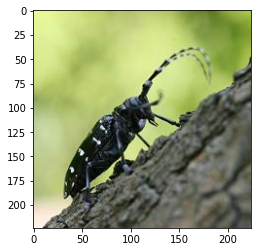

2
['10', '568', '402', '526', '137']


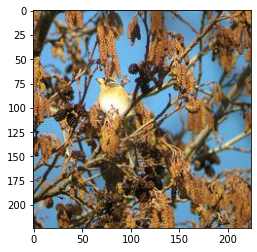

(25, 5)
tf.Tensor([4 4 1 4 4 4 4 4 4 4 3 2 4 4 4 4 2 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 1 1 3 1 4 2 4 4 1 4 4 3 1 4 1 4 1 4 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 3 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 4 3 4 1 4 4 4 4 4 3 4 4 4 4 4 1 4 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 0 0 3 3 3 0 0 2 3 1 0 4 1 4 0 2 1 3 4 0 3 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 3 4 3 3 4 4 3 3 3 4 3 3 3 3 3 3 3 3 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 0 0 4 0 0 3 3 0 3 3 3 0 0 3 3 3 3 0 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 4 1 3 3 1 3 3 1 1 1 1 1 3 1 1 4 1 1 1 3 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 1 1 2 2 1 1 0 2 2 1 1 2 2 2 2 1 2 1 2 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 1 1 3

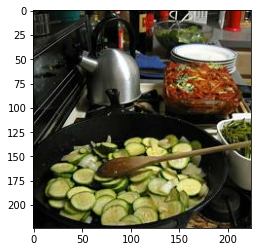

4
['655', '299', '653', '973', '920']


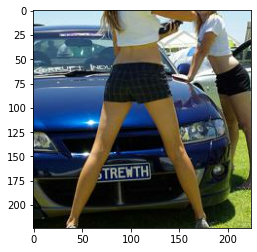

(25, 5)
tf.Tensor([4 4 4 4 2 4 4 4 4 1 3 4 4 4 4 3 4 4 4 4 4 2 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 3 1 4 3 1 4 4 1 1 4 1 4 4 1 4 1 4 3 1 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 3 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 1 4 4 4 4 4 4 4 4 4 4 4 4 4 4 2 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 0 0 0 0 0 0 0 4 0 0 3 3 1 3 3 3 3 3 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 1 1 0 3 3 1 3 4 4 0 4 4 0 3 3 1 3 3 3 1 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 2 0 2 0 1 4 4 2 4 4 2 4 2 2 2 0 4 4 2 0 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 1 0 4 0 1 0 4 4 0 4 4 4 4 0 0 4 0 4 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 3 4 3 3 0 1 3 4 3 1 4 3 4 3 1 4 3 3 3 3 3 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 1 4 1 1 1 1 1 1 1 1 4 4 3 1 4 4 4 1 4 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 3 1 4

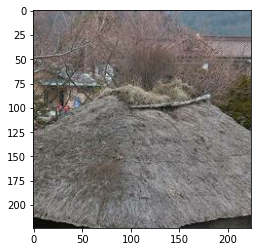

2
['467', '404', '58', '198', '84']


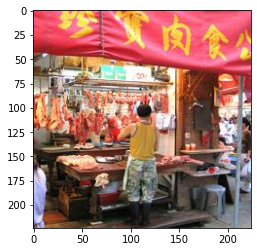

(25, 5)
tf.Tensor([4 4 1 3 4 4 4 4 4 4 0 4 4 3 4 4 1 4 4 3 3 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 0 4 1 1 0 4 1 4 1 1 0 3 3 4 1 1 1 1 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 0 4 0 1 4 1 4 4 3 0 3 4 0 0 3 0 3 1 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 0 4 4 4 4 4 4 4 4 4 0 0 0 0 0 4 4 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 4 1 0 4 0 1 1 4 4 4 0 4 0 4 0 0 1 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 0 4 4 0 4 4 0 4 4 4 0 4 0 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 0 2 1 1 1 1 1 0 1 0 2 1 1 0 2 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 4 4 4 0 0 4 0 4 0 0 4 0 0 4 0 4 4 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 4 4 4 0 0 4 4 0 1 0 4 1 0 4 4 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 0 0 0 1 1 1 1 0 0 1 1 0 1 0 0 1 1 1 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 1 4 0

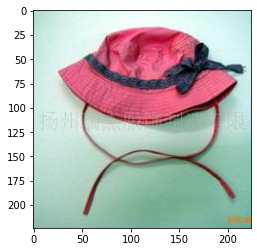

3
['217', '965', '38', '57', '346']


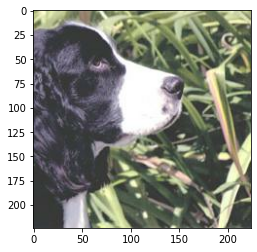

(25, 5)
tf.Tensor([4 4 0 4 4 4 0 4 4 4 0 0 4 0 0 4 0 0 0 4 0 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 4 4 4 4 3 4 4 4 3 3 4 4 4 4 4 3 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 1 1 1 1 1 1 1 1 1 4 1 1 1 1 4 1 1 1 1 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 4 4 1 1 1 1 4 4 1 1 1 1 1 1 1 4 4 1 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 1 2 4 4 0 2 4 0 4 2 4 0 0 2 2 2 4 4 2 2 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 2 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 4 4 0 2 2 4 2 0 4 1 4 4 4 2 1 4 4 0 0 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 4 2 1 4 2 2 4 2 2 4 1 2 2 4 4 2 2 4 2 2 4 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 1 1 4 2 4 1 1 4 1 2 4 2 1 1 0 0 1 2 2 1 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 2 0 1 1 2 1 0 1 2 2 1 2 1 2 1 0 2 1 2 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 0 0

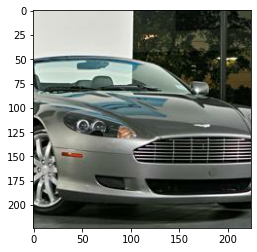

2
['276', '848', '541', '434', '298']


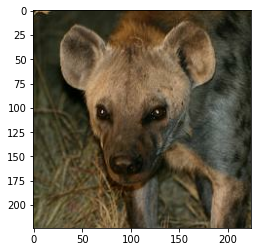

(25, 5)
tf.Tensor([4 4 4 4 0 0 0 4 0 4 4 4 4 4 4 4 0 4 4 4 4 4 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 2 0 4 2 2 2 0 2 0 1 2 2 4 0 1 2 1 0 4 1 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 0 0 1 1 1 0 1 1 1 0 0 1 0 0 0 0 1 1 0 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 2 4 1 4 2 1 2 1 1 0 2 1 2 0 2 1 4 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 3 4 3 4 3 3 1 3 3 3 4 3 1 3 3 4 2 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 3 3 3 2 3 3 3 3 3 3 2 3 3 3 3 2 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 0 2 1 2 2 2 1 2 3 2 1 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 4 1 1 1 4 1 1 1 1 4 1 1 1 1 4 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 1 4 3 3 1 4 2 4 4 4 1 4 2 2 4 4 4 4 4 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 2 1 0 3 3 4 1 0 0 1 3 0 2 2 2 2 3 2 3 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 4 2 2

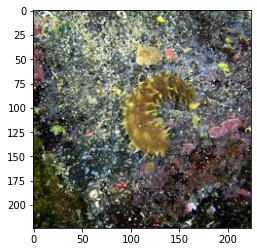

0
['676', '972', '834', '227', '456']


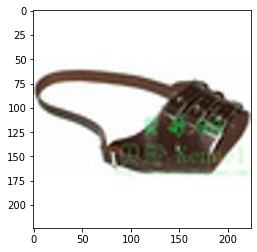

(25, 5)
tf.Tensor([4 4 4 4 3 4 4 2 4 4 0 4 4 4 4 4 4 0 4 4 4 4 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 2 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 0 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 1 1 1 1 3 3 4 0 1 0 0 3 1 0 0 0 0 3 1 3 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 4 0 0 0 0 0 0 1 0 0 3 1 1 0 0 0 4 1 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 4 3 2 3 1 4 4 3 3 3 2 3 2 1 1 2 1 2 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 2 1 4 1 0 4 4 1 1 1 4 1 4 4 4 4 4 1 3 1 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 0 1 1 1 1 4 4 4 1 1 0 3 4 0 0 0 1 0 3 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 4 4 3 4 4 4 4 4 4 4 4 3 3 4 4 4 3 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 0 2 4

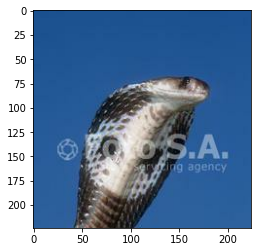

2
['653', '809', '11', '595', '281']


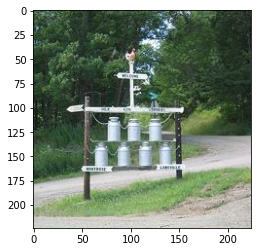

(25, 5)
tf.Tensor([0 0 4 3 4 4 4 4 4 4 3 4 4 4 4 4 4 0 2 4 4 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 2 1 4 4 4 4 1 1 4 2 4 1 1 4 1 4 4 1 4 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 2 2 2 2 2 4 2 2 2 2 2 4 2 2 4 2 2 2 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 3 3 3 3 3 4 3 4 3 1 2 3 4 4 3 3 4 4 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 0 3 0 0 3 0 0 0 0 3 0 0 0 2 3 0 0 0 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 3 3 1 1 3 1 3 2 3 2 1 3 1 4 2 1 1 3 3 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 3 2 3 2 2 2 3 3 3 2 2 3 3 2 0 0 3 3 2 3 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 3 4 0 0 3 4 4 3 0 2 0 2 0 0 0 2 2 0 0 0 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 4 4 1 2 0 0 2 0 0 4 4 0 0 0 0 0 0 0 0 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 2 2 3 2 2 3 2 2 0 2 2 0 2 2 2 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 3 4 0

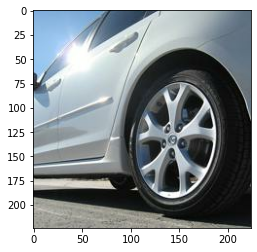

2
['528', '769', '854', '828', '310']


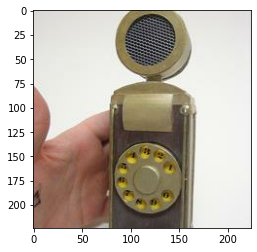

(25, 5)
tf.Tensor([2 4 4 4 2 4 4 4 4 4 2 4 4 2 4 4 4 3 4 4 2 3 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 3 4 1 3 4 4 4 3 3 4 4 3 2 4 1 4 3 2 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 1 4 4 2 2 2 4 1 2 4 4 2 4 3 2 4 4 4 2 4 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 0 1 2 2 2 2 2 2 2 2 4 2 2 2 2 3 2 2 1 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 0 1 1 2 1 0 1 0 0 1 0 1 1 0 0 0 1 1 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 1 0 1 1 1 4 0 1 0 1 1 1 1 1 4 1 2 1 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 4 2 0 2 0 0 4 3 0 2 4 2 1 3 0 2 2 2 0 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 1 1 2 1 1 2 2 2 1 1 1 1 1 2 1 2 1 3 1 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 0 0 0 4 0 2 2 0 2 2 0 0 2 0 1 0 0 2 2 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 4 1 2 2 1 4 1 4 4 2 2 1 2 1 1 4 4 2 2 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 2 1

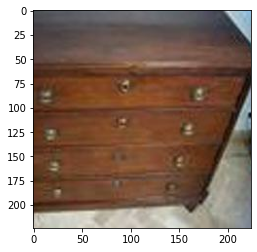

0
['17', '710', '921', '989', '624']


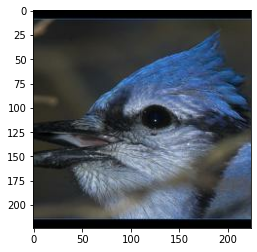

(25, 5)
tf.Tensor([4 3 2 2 4 2 4 0 3 4 0 3 4 1 4 4 3 4 0 4 2 2 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 0 0 0 0 2 0 0 0 0 0 0 2 2 0 0 2 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 3 3 0 0 0 0 0 0 0 0 0 0 0 0 3 3 3 0 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 4 0 4 4 0 0 0 0 4 0 1 4 4 0 1 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 4 3 3 4 3 4 0 3 4 1 3 4 4 1 3 4 3 4 0 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 0 3 3 3 3 4 4 0 4 3 0 0 0 4 4 3 3 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 4 3 3 1 3 4 0 3 1 3 3 1 1 3 1 3 1 0 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 0 1 1 0 1 4 4 1 4 0 4 4 4 1 1 4 0 0 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 4 4 4 0 2 0 4 4 4 4 4 4 4 4 0 1 0 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 0 2 4 4 4 4 4 2 0 4 4 1 2 2 4 4 0 2 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 3 4 4

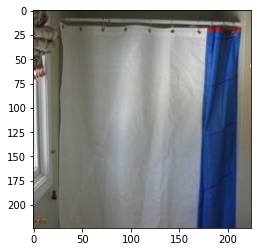

0
['788', '746', '352', '680', '929']


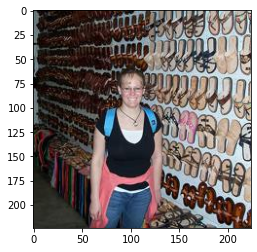

(25, 5)
tf.Tensor([4 0 4 0 4 4 4 2 4 0 4 3 0 0 4 0 0 3 0 4 4 4 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 4 4 4 3 2 4 4 3 4 3 4 4 4 3 0 4 4 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 3 3 0 0 3 0 0 3 3 3 3 0 3 0 3 3 0 3 3 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 1 1 4 1 1 1 4 1 1 4 1 1 4 1 1 0 4 4 1 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 1 4 1 0 4 4 1 4 4 1 1 1 0 4 4 0 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 0 0 1 4 1 1 4 1 1 4 1 4 1 4 2 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 3 0 0 0 3 0 4 3 0 0 0 0 0 3 0 4 4 3 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 0 0 3 3 3 0 3 0 0 0 0 3 3 3 3 3 3 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 0 2 2 0 0 2 0 2 2 0 2 2 0 2 0 0 0 0 2 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 4 2 2 1 2 1 0 1 2 2 0 2 2 1 4 0 0 0 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 2 1 4 4

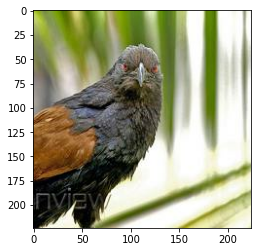

3
['278', '447', '280', '574', '663']


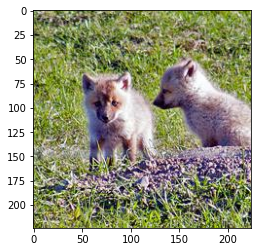

(25, 5)
tf.Tensor([0 3 4 0 4 4 4 4 3 3 0 4 3 4 3 3 4 4 4 2 4 3 4 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 0 4 4 0 1 0 0 4 1 0 4 0 4 0 4 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 0 1 4 2 3 3 3 0 0 3 3 0 4 0 3 0 0 0 3 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 4 0 0 0 3 1 4 0 1 0 0 0 1 3 3 0 0 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 3 4 2 4 4 3 4 2 3 4 4 4 4 4 0 4 0 0 4 4 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 4 3 4 3 4 3 3 3 3 3 0 3 0 3 0 4 4 3 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 3 0 3 4 4 3 4 4 4 3 4 4 0 0 3 4 3 0 4 4 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 1 2 2 2 2 2 1 1 2 1 1 2 2 1 1 2 2 2 2 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 0 0 4 4 0 0 4 0 0 4 4 1 0 0 0 1 0 0 4 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 0 0 1 1 0 1 0 1 1 0 0 0 0 1 0 0 0 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 0 0 0

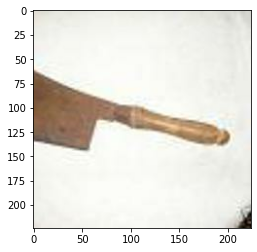

2
['394', '375', '337', '935', '550']


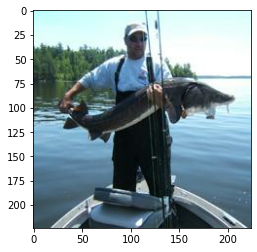

(25, 5)
tf.Tensor([2 2 4 1 0 0 1 1 0 4 4 0 4 0 0 4 1 2 1 3 0 1 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 4 1 0 1 1 1 3 1 1 1 1 0 1 0 3 1 1 3 3 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 3 4 0 3 3 4 3 0 0 0 4 0 0 4 0 3 0 0 4 3 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 2 0 0 0 0 0 0 2 2 2 0 0 0 0 0 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 2 0 0 0 0 2 4 4 4 0 0 4 4 3 0 2 0 0 0 3 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 3 4 0 0 0 3 0 3 4 0 3 0 0 0 3 0 3 3 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 0 0 3 0 0 3 3 0 4 0 0 0 0 0 0 0 0 3 4 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 3 3 4 4 3 3 4 4 4 4 4 4 4 3 3 4 4 4 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 3 2 4 3 4 0 2 2 3 0 2 3 2 3 0 3 2 2 2 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 4 4 0 4 3 3 4 0 0 0 0 3 4 3 3 3 0 0 4 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 0 0

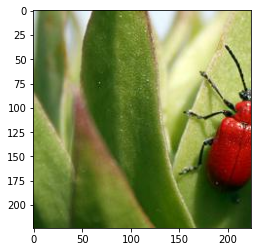

3
['652', '772', '712', '474', '426']


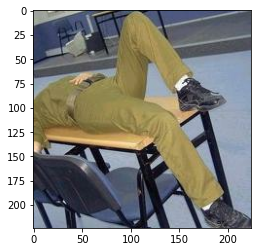

(25, 5)
tf.Tensor([4 2 0 4 0 0 3 4 0 4 4 1 0 4 0 0 2 3 0 0 0 4 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 1 1 3 1 1 1 3 3 3 1 1 1 0 1 0 1 3 3 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 2 0 0 0 4 0 4 4 0 0 0 0 0 0 0 2 4 0 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 4 4 0 4 4 4 4 2 4 0 4 4 4 4 4 4 4 4 0 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 4 4 4 4 4 4 0 4 4 2 4 4 4 4 2 2 2 0 2 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 4 4 4 2 4 2 4 2 4 4 4 2 4 4 4 4 4 4 4 4 4 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 0 4 4 0 4 4 0 0 0 4 4 2 4 4 4 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 0 2 0 0 4 0 0 4 0 4 0 4 4 0 0 4 4 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 1 0 0 2 2 1 1 0 0 1 1 1 0 1 1 1 1 0 0 2 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 3 3 1 1 0 1 0 3 0 1 1 3 1 1 1 1 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 0 0 0

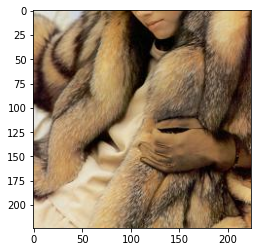

1
['716', '200', '376', '553', '390']


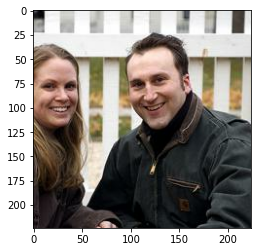

(25, 5)
tf.Tensor([0 0 0 0 0 0 1 2 0 2 0 0 0 0 0 2 0 0 1 0 0 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 0 0 2 2 0 2 1 1 1 2 2 2 1 3 3 0 1 0 3 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 1 3 3 1 1 1 1 1 3 3 3 3 0 3 3 3 0 0 1 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 0 1 1 3 3 3 3 0 0 0 3 3 0 3 0 1 3 3 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 2 3 3 0 0 2 0 3 2 0 0 0 0 0 2 0 2 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 0 3 4 3 4 0 4 4 4 3 3 0 0 3 3 3 0 0 0 4 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 0 3 4 2 0 2 0 0 3 0 0 0 0 2 0 0 0 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 0 3 0 0 0 0 0 0 0 0 3 3 3 0 3 3 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 0 3 0 2 3 0 2 2 2 2 3 0 2 2 2 3 2 0 2 2 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 3 0 0 3 0 3 0 4 0 0 0 4 3 0 4 4 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 0 0 3

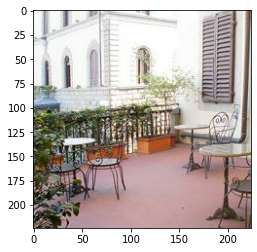

1
['784', '4', '341', '974', '22']


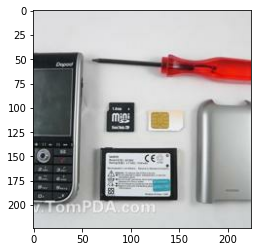

(25, 5)
tf.Tensor([1 1 1 1 0 0 1 2 2 0 1 1 1 0 0 1 0 1 0 0 0 0 2 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 1 1 1 1 2 1 0 1 1 0 1 0 1 1 0 0 0 0 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 2 1 0 1 1 0 0 3 0 1 1 0 0 0 0 3 1 1 0 0 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 2 0 0 0 1 0 1 0 0 3 0 0 1 0 1 1 1 0 1 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 2 4 2 1 4 4 2 2 2 1 4 2 2 4 4 1 2 4 2 4 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 1 1 1 1 1 1 1 1 1 1 1 2 4 1 2 1 1 1 2 4 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 2 2 2 0 0 0 0 0 0 0 0 0 0 0 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 4 2 0 2 2 2 2 2 2 2 2 0 2 2 2 2 3 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 0 2 2 2 2 2 0 2 0 3 2 2 0 0 0 3 2 3 0 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 0 1 2 4 0 2 2 2 1 2 2 2 1 2 2 2 2 1 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 1 2 1 2

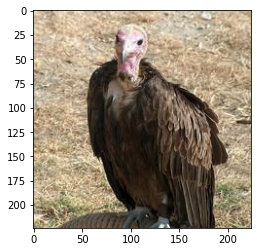

1
['734', '65', '834', '339', '990']


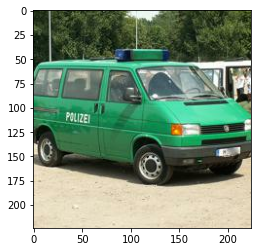

(25, 5)
tf.Tensor([2 1 1 2 2 0 2 0 2 2 2 0 2 0 1 2 0 0 2 0 2 2 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 1 4 1 3 4 1 4 4 3 4 4 4 3 1 4 4 1 4 4 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 0 4 4 2 0 1 4 4 4 4 4 0 4 0 1 1 4 1 4 4 4 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 1 1 1 3 2 1 1 0 0 1 3 1 1 3 3 3 2 2 1 1 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 1 4 4 0 1 0 1 1 0 4 1 4 4 4 1 4 1 4 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 1 1 1 4 1 4 4 4 4 4 4 1 4 1 4 4 1 2 4 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 4 2 4 4 4 4 4 4 4 4 4 4 4 2 4 2 2 1 1 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 3 2 0 3 0 0 3 3 3 3 0 1 1 0 3 0 0 0 2 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 1 0 2 3 0 3 0 0 0 3 1 2 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 2 0 1 1 3 3 3 3 3 3 1 3 1 3 3 0 2 1 1 1 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 1 4 1 4

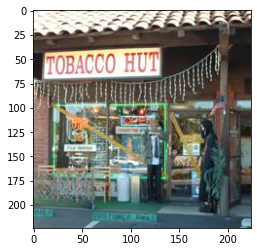

0
['589', '508', '754', '937', '969']


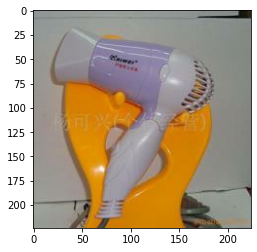

(25, 5)
tf.Tensor([0 2 2 2 2 0 2 0 2 0 0 0 0 2 0 0 3 0 0 3 2 3 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 3 0 0 0 0 0 3 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 4 0 4 4 0 0 4 0 0 0 0 0 4 0 4 0 0 4 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 0 4 4 4 4 4 4 4 0 0 0 4 4 4 4 0 0 4 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 2 0 3 3 0 0 0 3 0 0 0 3 0 0 3 0 0 3 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 3 3 0 0 3 3 3 0 0 2 0 3 2 0 3 3 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 4 4 4 0 0 0 2 0 4 0 4 4 0 4 4 4 0 0 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 2 2 2 2 4 3 3 2 2 2 2 2 0 3 0 0 0 2 2 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 2 2 3 3 3 3 2 3 0 3 0 2 3 3 3 3 2 3 3 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 4 4 2 2 4 0 4 2 2 0 4 2 0 4 0 0 0 0 0 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 0 3

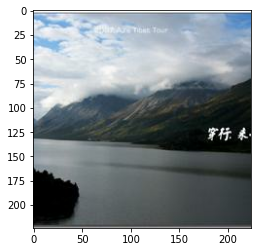

2
['235', '503', '734', '87', '325']


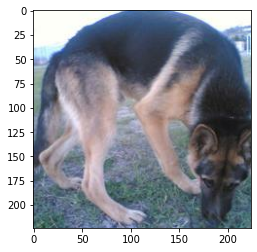

(25, 5)
tf.Tensor([0 0 2 0 0 0 2 0 2 0 0 2 3 0 2 3 0 0 2 0 0 2 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 4 1 2 2 2 4 1 1 1 2 2 2 2 2 4 2 2 1 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 2 4 4 4 2 2 1 4 4 2 1 2 2 4 2 2 2 2 2 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 1 4 4 4 1 4 4 1 4 1 1 0 4 4 1 0 1 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 1 4 0 0 0 1 4 4 4 0 1 0 1 0 1 1 4 0 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 1 0 1 4 4 1 1 1 4 4 4 4 4 4 4 1 4 4 1 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 1 1 1 1 1 0 1 0 1 4 1 1 1 1 1 1 1 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 4 4 4 2 2 4 2 2 2 2 4 2 4 2 2 2 2 4 4 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 2 0 2 1 1 0 4 0 1 2 4 1 1 1 2 2 0 4 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 4 1 2 4 1 1 1 1 1 1 1 4 1 0 4 1 1 4 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 2 1 4

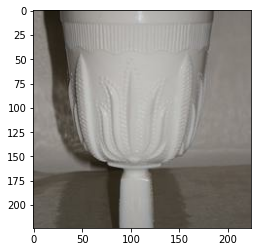

1
['495', '764', '247', '473', '824']


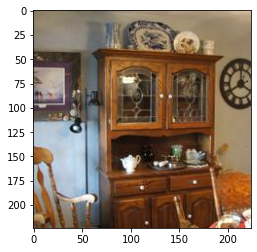

(25, 5)
tf.Tensor([0 2 1 0 4 0 4 3 2 0 1 0 1 1 0 0 1 4 4 0 4 0 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 0 2 1 2 2 2 2 0 2 0 0 2 2 2 3 2 3 3 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 1 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 0 0 0 3 1 1 0 3 0 1 3 0 0 0 0 3 3 1 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 1 1 0 0 0 3 3 0 0 3 3 1 0 1 3 1 3 2 0 2 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 3 1 0 3 3 3 3 0 0 3 1 0 0 0 0 0 0 1 0 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 0 0 0 3 0 0 0 3 0 3 0 0 3 3 0 3 0 3 0 3 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 2 3 3 0 3 0 0 3 2 3 0 0 3 3 0 2 0 0 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 1 0 0 3 3 0 0 3 0 0 1 1 3 0 0 1 3 1 1 1 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 3 3

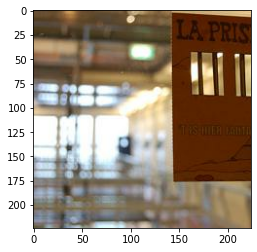

3
['682', '883', '633', '210', '114']


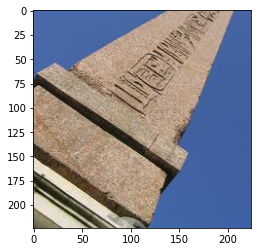

(25, 5)
tf.Tensor([1 0 1 0 0 0 0 0 1 0 0 0 1 1 1 0 1 0 0 0 0 4 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 0 1 1 1 0 0 0 0 1 1 0 0 1 1 4 1 4 4 4 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 4 0 0 4 0 0 0 0 0 0 0 4 4 0 0 0 0 4 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 4 1 4 0 4 0 0 2 1 4 4 4 2 0 0 3 0 0 4 4 2 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 0 2 4 0 2 2 0 2 0 0 0 2 2 0 2 0 0 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 0 0 0 0 2 0 4 4 0 2 0 0 0 0 0 0 0 2 2 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 2 2 2 0 0 2 0 2 4 2 2 0 0 2 2 4 0 0 0 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 0 2 4 0 4 2 0 4 4 0 0 4 0 0 0 4 0 2 2 0 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 0 0 2 4 0 0 4 0 2 0 4 2 0 4 4 4 4 2 4 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 4 0 0 0 4 0 4 4 4 0 0 0 4 4 0 0 0 2 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 4 4 2

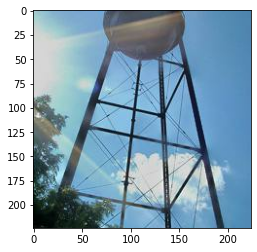

2
['497', '169', '380', '705', '92']


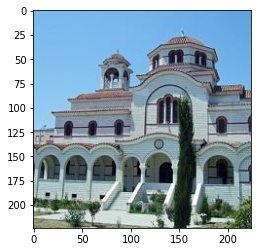

(25, 5)
tf.Tensor([4 0 0 0 0 3 0 0 0 0 0 0 0 0 4 1 0 0 1 0 0 1 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 0 0 0 0 0 0 4 0 0 0 0 0 0 0 0 0 0 4 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 0 0 2 4 0 0 0 2 0 0 0 4 0 0 0 2 0 0 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 1 4 0 0 2 0 4 0 0 2 2 0 0 0 0 4 0 2 2 0 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 2 0 0 2 0 0 2 0 2 0 4 0 0 0 0 0 0 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 2 0 0 0 0 0 0 0 0 0 0 2 0 0 0 2 4 0 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 4 0 0 4 0 0 2 2 0 2 0 0 0 0 0 0 4 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 2 2 1 4 3 3 2 2 4 2 3 1 3 1 3 1 2 2 4 3 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 0 3 2 1 2 1 4 1 2 0 1 3 3 1 3 2 2 2 1 2 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 0 3

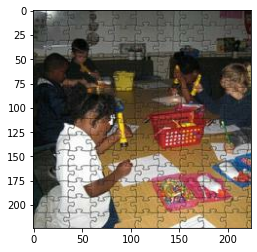

1
['337', '350', '469', '916', '92']


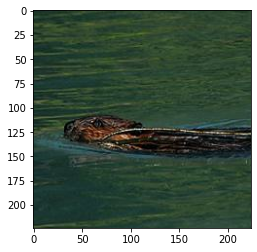

(25, 5)
tf.Tensor([0 0 2 4 0 0 4 4 4 0 0 2 0 4 4 0 0 0 0 2 4 0 2 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 3 2 3 3 3 3 4 3 2 2 2 2 2 3 2 2 3 4 3 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 3 2 2 3 3 2 2 2 2 2 3 3 3 3 2 2 2 2 2 2 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 2 2 3 2 3 2 3 3 3 3 2 3 2 3 3 3 2 2 3 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 3 2 3 2 3 2 2 3 2 3 3 2 3 3 2 2 0 3 1 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 0 2 3 3 2 0 2 3 3 2 3 2 3 3 3 4 2 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 3 2 3 3 3 3 2 3 3 2 3 3 2 3 2 3 3 2 2 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 3 3 3 3 3 3 3 3 0 2 2 3 3 3 3 3 3 2 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 2 0 2 2 2 2 2 2 2 0 2 2 0 2 2 0 0 2 0 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 4 4 0

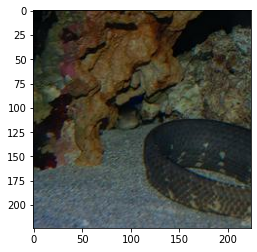

2
['494', '158', '575', '463', '330']


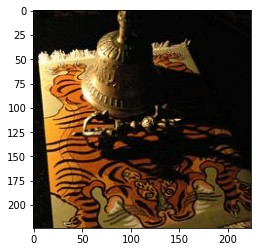

(25, 5)
tf.Tensor([2 2 4 2 1 2 1 0 4 0 0 2 2 2 2 4 1 2 4 1 4 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 4 0 1 0 0 1 0 1 1 4 4 4 0 0 0 1 1 4 1 0 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 2 2 2 2 2 2 2 2 2 2 2 2 4 2 2 2 2 4 2 2 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 0 0 2 0 0 0 2 4 2 0 0 4 4 0 0 2 4 0 2 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 1 4 1 4 0 0 0 4 4 1 1 1 1 1 0 0 0 1 4 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 3 3 1 3 0 0 0 1 0 1 0 1 1 1 0 3 0 1 2 2 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 4 4 4 2 2 3 2 4 0 2 1 0 4 4 4 0 2 4 0 0 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 1 4 1 2 4 2 4 4 1 3 4 4 1 4 4 4 4 4 4 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 3 2 2 3 2 2 0 0 3 3 2 2 2 0 2 0 3 0 3 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 4 2 2

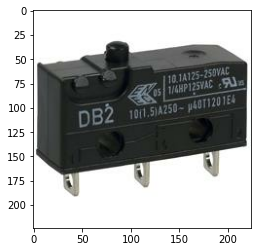

1
['559', '177', '189', '619', '45']


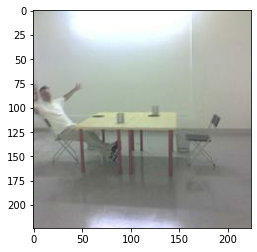

(25, 5)
tf.Tensor([1 2 2 1 1 2 1 2 2 2 0 4 2 0 1 2 2 2 4 4 2 4 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 3 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 3 1 1 1 1 1 4 3 1 1 4 1 3 1 3 1 1 3 3 1 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 1 1 4 4 3 3 4 4 1 3 1 3 1 1 1 1 1 3 2 3 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 2 2 2 1 3 1 3 4 1 2 3 4 2 0 3 4 1 1 3 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 1 4 3 4 1 3 4 1 4 1 4 1 1 3 3 3 3 4 1 3 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 4 4 4 1 4 0 4 4 4 4 0 1 0 4 1 4 1 1 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 2 1 0 0 0 0 2 2 1 0 2 0 1 0 1 0 0 0 0 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 1 2 2 0 3 3 0 3 2 3 2 0 1 1 4 0 3 3 2 2 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 0 4 4 4 4 4 4 0 0 4 4 0 0 4 4 2 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 0 0 2

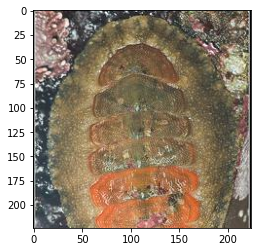

1
['300', '693', '809', '905', '94']


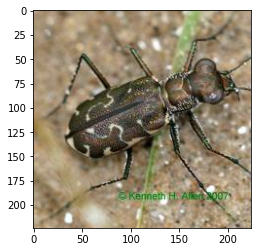

(25, 5)
tf.Tensor([4 4 1 1 4 1 1 1 2 0 4 4 4 0 0 4 1 4 0 1 2 1 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 2 4 2 4 2 1 4 2 2 0 0 0 0 2 0 1 2 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 4 0 1 4 4 4 1 4 4 1 4 1 4 3 0 4 4 4 0 4 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 4 0 4 2 2 2 4 4 2 4 4 4 1 0 0 4 2 2 4 2 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 1 2 2 1 2 2 2 2 2 2 1 2 2 1 1 2 1 2 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 1 1 0 0 1 0 3 0 2 2 1 1 4 1 2 0 1 0 1 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 4 2 2 2 1 2 4 2 1 1 1 2 1 2 1 2 2 1 1 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 2 1 1 1 2 1 1 1 1 0 4 1 1 2 1 2 1 2 1 2 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 1 0 2 2 1 2 2 1 1 1 2 2 1 2 4 1 1 1 2 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 2 4 1 1 1 1 1 1 2 1 4 2 2 1 2 1 2 4 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 2 1 2

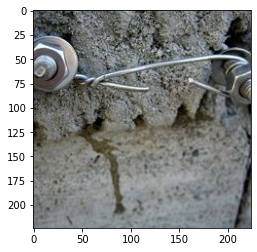

2
['656', '715', '459', '502', '365']


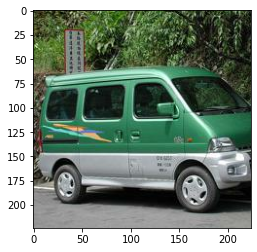

(25, 5)
tf.Tensor([3 1 4 1 4 2 1 0 4 1 1 0 4 2 2 1 4 3 0 4 2 1 4 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 2 1 1 1 2 2 1 1 2 2 1 2 2 2 2 2 1 1 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 0 0 2 2 0 0 0 2 0 0 2 2 2 2 0 0 0 0 2 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 0 3 3 0 0 4 0 0 4 4 3 0 0 4 4 0 4 4 4 4 3 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 4 0 0 4 0 4 0 3 1 3 4 0 0 3 1 0 1 3 4 1 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 3 3 3 4 0 3 0 3 3 3 0 3 0 3 3 4 0 3 3 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 1 0 4 0 4 4 0 0 0 4 0 4 4 0 4 3 4 1 4 0 0 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 0 0 2 2 0 2 0 0 2 2 2 2 2 2 2 2 2 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 0 4 3 4 4 4 0 4 2 1 1 0 3 4 4 0 3 1 2 1 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 0 2 2 0 0 0 0 0 0 2 2 2 2 0 1 2 0 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 2 1 0

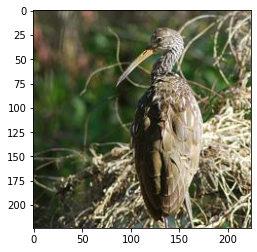

4
['749', '678', '549', '397', '861']


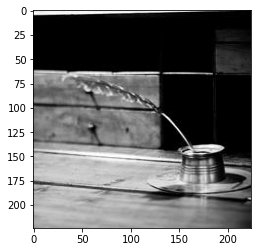

(25, 5)
tf.Tensor([4 1 0 4 4 3 4 1 0 0 0 0 4 2 4 0 0 0 4 0 4 3 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 4 0 4 0 4 4 4 0 0 0 4 4 4 0 0 0 0 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 3 0 0 1 0 1 1 1 0 2 1 0 0 0 1 1 1 1 0 2 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 3 4 4 3 3 1 3 1 3 1 3 1 1 3 4 2 1 3 3 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 1 2 2 2 0 2 3 2 3 1 1 1 2 2 2 1 2 2 2 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 1 1 3 1 1 1 2 1 2 2 1 1 2 2 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 0 3 2 0 0 3 3 3 1 4 1 1 0 3 0 1 1 1 1 2 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 4 3 4 1 4 1 4 3 4 3 3 3 4 4 3 3 4 3 3 4 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 4 1 4 1 1 3 3 3 1 4 1 3 4 4 4 4 1 4 4 3 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 3 3 4

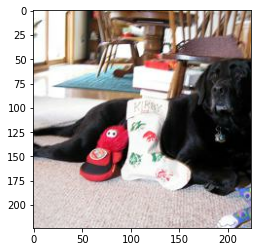

1
['942', '638', '108', '336', '245']


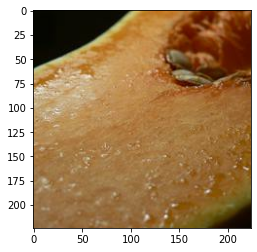

(25, 5)
tf.Tensor([2 0 4 4 0 4 4 4 0 0 4 4 4 4 0 4 0 4 4 4 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 1 1 2 0 0 0 0 0 0 0 2 1 0 2 0 0 0 1 1 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 1 1 0 1 1 1 1 0 0 0 1 0 1 0 1 0 1 1 1 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 0 1 1 1 0 1 1 0 4 4 1 0 0 4 2 1 0 1 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 1 4 4 4 0 0 0 1 0 4 0 0 4 1 4 4 0 1 4 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 4 4 0 0 1 0 0 4 0 0 0 1 4 0 0 0 0 0 0 0 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 2 1 2 1 1 2 2 2 1 2 2 2 2 1 1 1 2 2 1 1 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 1 1 1 1 2 1 2 2 1 2 1 1 1 2 2 1 2 1 2 2 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 0 1 1 1 0 1 1 2 0 2 2 1 1 2 2 2 1 2 1 2 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 2 1 0

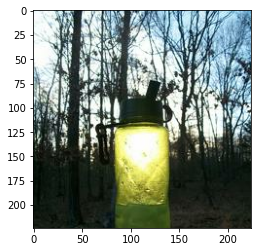

1
['212', '133', '66', '813', '813']


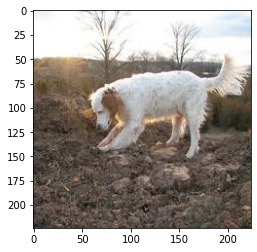

(25, 5)
tf.Tensor([4 4 1 0 1 4 1 0 4 1 0 4 4 1 1 1 2 4 4 4 4 4 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 2 1 1 1 1 2 1 1 2 2 1 1 2 2 2 1 2 2 1 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 1 1 2 1 1 2 2 1 1 2 1 1 1 0 2 1 2 1 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 0 2 1 1 2 2 2 1 2 1 0 1 2 1 2 1 2 2 1 1 1 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 1 2 1 2 1 2 2 1 2 2 4 4 2 2 3 1 3 2 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 1 2 3 2 3 2 3 1 2 3 3 1 2 3 2 3 2 1 1 2 2 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 1 2 2 3 3 3 3 3 1 4 3 3 4 2 3 3 1 2 2 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 4 4 2 4 2 1 4 2 4 4 4 2 4 4 2 1 4 3 4 4 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 3 0 0 0 2 2 0 2 0 0 0 0 3 0 0 2 3 2 0 2 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 3 3 3 3 2 3 4 2 3 3 2 3 2 3 2 4 4 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 2 0 0

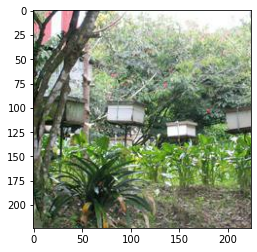

0
['521', '835', '964', '862', '330']


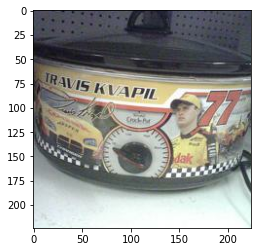

(25, 5)
tf.Tensor([0 0 2 4 2 1 1 4 2 2 1 0 4 1 1 1 1 2 1 2 2 4 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 2 1 1 1 1 0 0 1 0 0 0 2 2 0 1 2 0 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 3 3 3 2 3 2 3 3 2 1 2 2 3 2 1 1 2 2 2 2 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 1 1 1 1 1 2 2 2 1 2 2 2 2 2 2 2 2 2 1 2 1 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 1 4 1 1 1 1 1 1 4 4 1 4 4 4 4 1 4 4 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 2 4 1 1 1 1 2 1 1 1 1 2 2 2 1 2 2 1 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 1 1 1 1 2 2 2 2 1 1 1 1 2 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 4 1 2 2 4 2 1 1 1 4 1 1 2 2 1 1 1 2 1 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 0 2 0 0 1 0 0 4 2 0 4 0 1 0 0 1 1 2 1 2 2 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 1 1 1 1 3 2 4 2 3 2 3 2 1 1 3 4 2 2 1 2 2 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 2 4 3 2

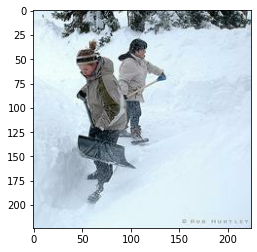

1
['317', '112', '952', '574', '464']


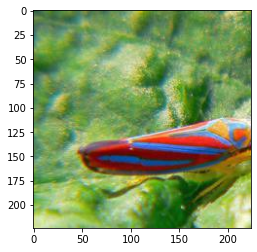

(25, 5)
tf.Tensor([1 4 2 1 1 4 4 4 1 4 4 2 4 2 4 4 2 4 1 1 1 2 1 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 1 2 1 3 1 2 4 1 4 1 4 4 1 4 4 3 4 4 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 2 1 2 1 1 1 1 1 1 1 2 2 2 1 1 1 2 1 2 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 1 0 1 3 0 1 1 3 1 3 3 3 1 0 1 1 1 0 3 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 1 0 1 1 0 0 0 0 0 1 0 1 0 0 1 0 1 1 1 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 1 1 0 0 0 1 0 0 1 3 1 0 1 0 1 1 0 1 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 1 1 1 2 1 3 2 3 2 2 1 1 3 0 3 1 1 3 3 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 4 2 1 3 0 1 3 3 0 0 1 2 0 1 1 0 0 3 1 1 1 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 3 0 1 0 1 0 0 0 1 3 0 3 0 2 3 3 0 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 0 2

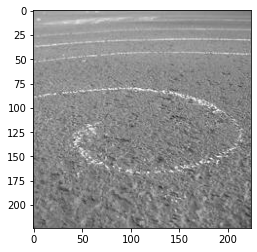

4
['783', '242', '432', '117', '80']


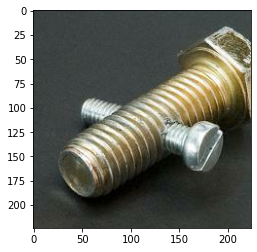

(25, 5)
tf.Tensor([1 4 4 4 4 4 4 1 1 0 0 1 1 4 4 1 1 1 4 1 1 1 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 4 1 1 4 4 1 4 3 4 1 4 4 1 1 1 1 1 1 1 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 1 4 4 1 0 1 1 4 1 1 4 4 4 0 3 4 4 1 4 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 1 1 0 3 3 1 0 1 1 0 1 0 4 3 0 0 0 0 3 1 3 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 2 4 2 1 1 3 2 1 1 4 0 1 1 1 2 3 1 2 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 2 3 2 3 1 4 0 0 4 1 3 1 3 3 3 3 1 1 4 4 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 4 1 0 4 1 1 1 4 1 4 4 1 1 1 0 0 1 1 4 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 4 0 1 1 0 0 4 0 0 4 1 4 4 0 0 0 1 0 3 0 3 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 4 1 4 1 4 3 1 0 4 3 4 1 0 1 3 1 0 1 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 3 3 1 3 1 1 1 3 0 1 3 0 3 1 3 3 1 1 1 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 1 3 3

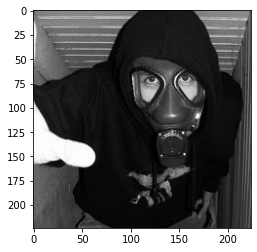

1
['137', '310', '442', '589', '838']


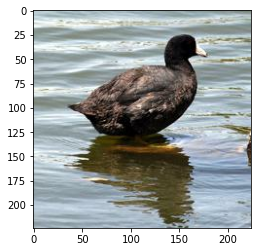

(25, 5)
tf.Tensor([1 2 4 4 1 4 4 1 2 1 1 4 4 4 4 1 1 3 4 4 4 2 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 1 0 1 0 1 0 4 0 0 0 0 0 0 4 1 4 0 4 4 1 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 3 1 4 1 1 1 1 1 1 1 1 1 1 4 1 1 1 1 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 2 2 4 2 1 2 0 1 2 2 2 2 2 1 3 1 1 3 1 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 1 1 1 4 4 2 1 3 4 2 3 2 1 4 1 2 3 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 1 3 2 2 3 2 2 3 2 3 2 3 2 2 2 3 2 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 2 4 4 2 3 2 3 2 3 2 2 2 2 2 2 2 2 4 2 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 1 1 3 1 4 1 1 2 1 2 4 1 3 1 4 1 2 1 1 4 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 2 3 1 1 4 2 1 4 2 4 2 1 2 1 3 4 4 2 4 1 1 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 2 4 0 4 1 4 2 0 2 1 0 2 1 2 4 2 1 0 4 0 4 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 4 0 0 4

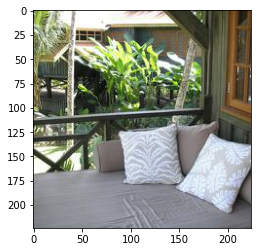

3
['67', '235', '910', '697', '720']


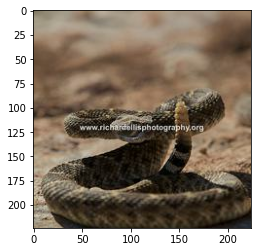

(25, 5)
tf.Tensor([1 1 4 1 4 4 1 1 4 1 1 1 1 4 1 3 1 3 2 1 4 4 4 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 1 4 4 4 4 4 1 4 0 4 3 4 4 4 4 0 4 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 4 4 2 2 3 4 1 1 0 1 3 3 1 3 4 1 1 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 2 2 2 1 1 2 2 1 1 2 1 2 2 1 2 1 1 2 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 4 1 3 4 1 4 1 4 1 4 1 4 1 1 1 1 4 1 1 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 3 4 4 3 3 0 4 3 3 3 3 3 3 4 4 1 4 0 3 4 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 4 4 3 1 4 3 3 4 3 2 2 2 3 1 1 1 3 2 3 1 3 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 3 1 4 1 1 1 1 1 4 3 4 1 3 1 4 1 1 4 2 2 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 3 4 1 4 1 1 1 4 1 4 1 1 1 4 1 3 4 3 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 3 4 0 3 4 4 4 3 0 0 4 4 4 3 0 0 0 4 0 3 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 4 4 1

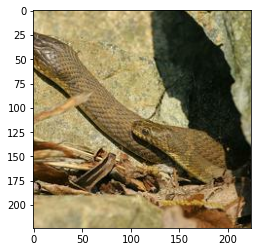

1
['872', '826', '349', '599', '709']


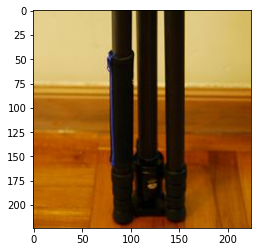

(25, 5)
tf.Tensor([1 4 3 3 4 1 4 1 4 1 1 4 3 3 3 2 3 1 2 4 1 3 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 3 3 1 1 3 1 1 1 1 1 1 1 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 1 1 1 1 1 1 3 1 1 3 1 1 3 3 3 3 0 3 3 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 1 1 1 1 1 1 1 1 1 3 4 3 4 4 1 1 1 1 1 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 0 3 0 3 0 0 0 0 3 3 0 3 0 4 0 0 0 0 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 4 0 3 4 0 4 4 0 0 4 0 0 0 4 0 3 1 3 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 3 0 0 0 0 3 3 0 0 0 4 0 3 0 0 0 0 3 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 3 3 3 3 0 4 0 3 3 3 1 4 3 4 0 3 0 0 4 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 0 0 0 4 0 0 4 0 0 0 0 0 0 0 4 2 4 0 4 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 0 0 0 1 3 2 0 3 1 1 3 0 3 3 4 3 1 1 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 0 0 4

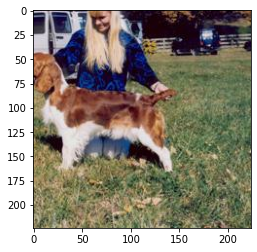

2
['154', '824', '941', '262', '439']


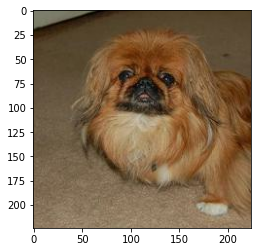

(25, 5)
tf.Tensor([1 3 3 0 0 1 0 1 0 1 0 4 4 1 3 1 4 3 3 1 3 4 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 1 0 2 1 1 1 1 4 0 1 1 2 3 1 2 1 1 1 0 1 1 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 2 1 4 4 1 4 4 4 1 4 4 1 1 1 4 1 2 4 4 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 2 2 1 2 1 1 1 1 2 1 2 1 1 4 2 1 4 2 1 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 4 4 1 1 1 1 1 0 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 4 1 1 1 1 4 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 2 1 1 2 1 0 1 1 0 2 0 4 1 2 1 2 1 1 2 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 4 4 1 1 1 1 4 1 1 2 2 2 1 2 4 4 4 4 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 2 0 2 4 1 2 2 1 4 4 0 2 2 1 2 1 4 1 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 4 4 2 0 4 4 2 0 2 0 4 4 4 4 4 2 2 1 1 0 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 1 4 0

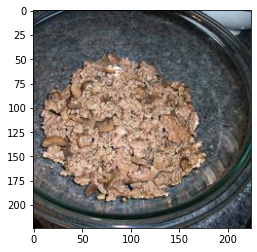

1
['955', '210', '742', '514', '205']


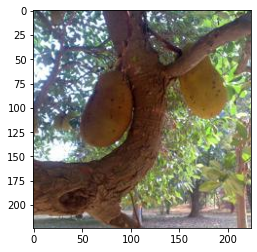

(25, 5)
tf.Tensor([0 0 0 0 4 0 0 0 1 0 0 1 0 0 3 1 1 0 1 1 3 1 1 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 3 4 3 1 4 3 3 4 1 4 4 3 1 3 1 1 1 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 1 3 3 3 1 3 3 3 4 3 3 1 1 1 3 3 1 3 3 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 1 0 1 1 1 0 0 0 0 0 1 1 1 0 0 0 1 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 1 0 0 1 1 1 1 0 1 0 0 4 0 4 0 0 1 1 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 3 1 0 0 0 0 2 3 0 1 2 0 2 1 0 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 3 0 2 2 2 0 2 3 2 0 2 2 2 0 0 0 0 0 0 0 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 2 3 3 2 2 1 0 2 3 3 0 1 2 3 3 3 3 1 2 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 0 4 0 1 1 1 0 0 3 1 4 0 0 3 4 3 3 4 1 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 4 4 0 3 4 0 0 0 0 1 0 3 0 0 3 0 0 1 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 1 1 0

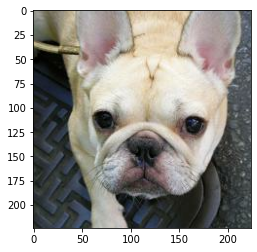

0
['87', '93', '429', '66', '529']


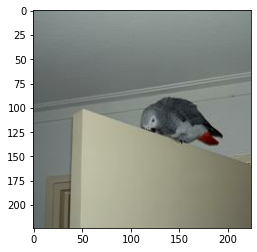

(25, 5)
tf.Tensor([1 1 1 1 4 0 0 0 1 1 0 4 0 1 1 1 4 4 1 0 4 1 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 1 0 0 0 0 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 1 2 2 1 1 1 2 2 1 2 1 2 2 2 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 4 2 4 2 4 1 4 4 4 4 4 4 4 4 4 4 4 4 4 2 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 1 3 1 4 1 1 3 1 1 4 1 1 1 3 1 3 1 3 1 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 1 1 1 1 4 4 4 1 4 3 1 1 1 1 4 1 1 1 1 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 3 1 3 4 3 3 1 1 4 3 4 3 1 1 1 1 1 3 1 1 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 4 1 3 3 1 1 3 1 1 1 1 1 2 1 1 3 3 1 4 1 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 2 3 2 3 2 2 3 2 3 0 1 2 3 0 2 3 2 0 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 3 3 3 0 3 3 0 3 0 3 3 0 3 0 3 2 3 3 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 2 1 0

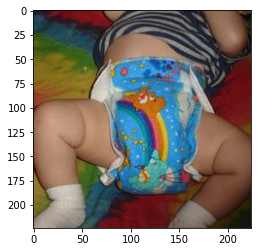

0
['885', '232', '536', '344', '739']


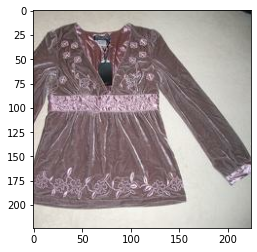

(25, 5)
tf.Tensor([4 1 1 4 4 1 4 1 4 4 4 4 0 1 1 4 1 1 1 1 4 3 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 4 2 4 2 2 2 2 2 2 2 3 2 2 2 4 4 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 1 2 1 3 1 1 4 1 1 2 1 2 1 1 1 1 3 1 1 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 1 2 2 1 3 2 1 2 1 1 2 2 3 3 1 4 1 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 2 2 2 2 2 4 4 2 2 1 2 2 2 4 2 2 1 1 2 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 4 4 2 1 2 2 2 1 2 2 2 4 2 4 2 1 1 1 2 2 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 2 4 4 4 4 4 4 2 4 4 2 4 4 1 4 4 3 4 4 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 1 4 1 3 2 4 1 2 2 4 1 4 4 1 4 4 2 4 1 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 1 2 2 0 1 2 1 0 1 1 0 0 1 0 2 0 2 0 0 2 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 2 0 0 0 0 2 2 2 0 0 0 0 2 0 2 0 2 2 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 0 2 0

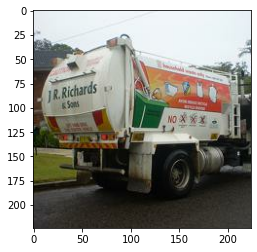

2
['287', '899', '807', '975', '658']


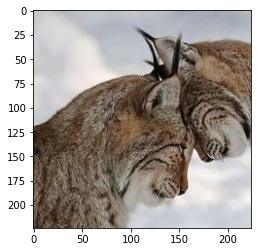

(25, 5)
tf.Tensor([3 1 3 1 1 2 2 4 2 4 1 4 4 1 3 4 4 1 1 4 4 4 1 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 4 4 1 4 4 4 1 4 1 1 4 4 4 4 1 4 1 1 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 2 2 2 2 2 1 2 1 2 2 2 2 1 2 2 1 2 1 2 2 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 2 4 4 1 1 1 1 4 1 2 4 1 1 2 1 1 1 1 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 1 0 3 3 3 3 3 4 3 3 4 4 3 1 4 0 1 1 0 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 4 3 3 3 3 4 0 3 3 0 0 3 3 0 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 3 0 1 3 0 1 3 3 4 1 0 4 0 3 1 0 3 4 1 0 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 2 4 2 4 0 0 0 4 4 0 2 4 4 0 2 4 2 4 2 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 2 2 1 0 2 0 0 4 0 2 2 2 0 0 2 0 2 0 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 2 2 2 1 0 2 0 0 4 1 0 0 1 0 1 2 0 4 0 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 4 0

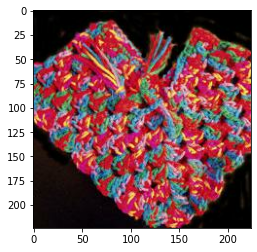

1
['809', '78', '229', '594', '975']


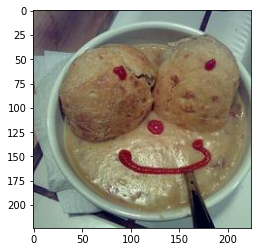

(25, 5)
tf.Tensor([1 4 1 1 0 4 0 1 4 1 1 1 1 4 1 4 1 1 4 2 1 1 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 1 0 1 0 4 4 1 1 4 4 4 4 1 4 4 1 0 1 1 3 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 4 0 4 4 0 0 0 0 0 1 0 1 0 4 0 1 1 0 1 0 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 2 0 1 0 4 0 0 1 0 0 0 4 0 0 4 4 4 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 4 4 4 1 4 4 1 4 4 1 4 4 4 1 4 4 1 1 4 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 3 4 4 4 4 4 4 4 1 4 4 1 3 4 1 3 1 4 1 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 4 3 3 4 4 4 3 4 4 3 0 4 4 0 4 4 4 4 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 0 1 0 1 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 0 1 0 0 1 0 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 0 1 1 0 1 1 1 1 1 0 1 1 0 1 0 1 0 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 0 4 0

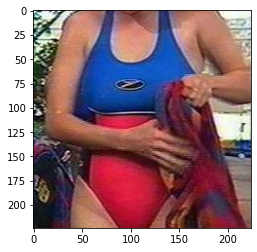

1
['353', '665', '845', '337', '850']


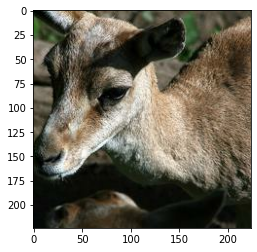

(25, 5)
tf.Tensor([1 0 1 1 0 1 0 1 4 3 1 1 1 1 4 1 0 1 1 1 0 1 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 1 4 1 1 4 1 4 1 1 4 1 1 1 4 4 4 1 4 4 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 1 1 0 1 0 1 3 1 1 3 0 1 3 0 0 0 1 1 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 4 1 4 1 0 1 0 1 1 0 0 0 0 1 0 1 1 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 2 1 0 1 0 0 4 1 0 4 4 1 2 0 1 4 1 0 2 1 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 4 1 1 1 4 4 1 4 1 4 1 4 1 0 1 1 1 1 1 4 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 4 4 1 4 4 1 2 2 0 4 4 1 4 1 2 4 0 2 2 2 4 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 2 1 0 1 4 0 0 0 4 1 1 1 1 1 1 1 1 0 0 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 1 0 0 0 0 1 0 0 1 1 0 0 0 4 0 0 0 1 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 4 4 4 4 2 2 2 0 2 2 4 2 4 4 2 2 1 2 0 2 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 2 1 2 3

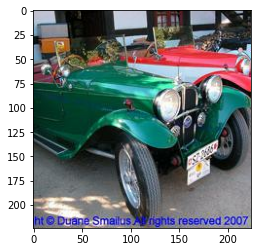

1
['579', '803', '156', '640', '595']


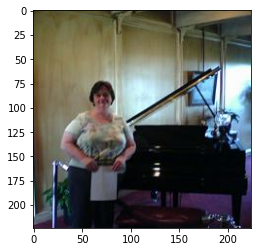

(25, 5)
tf.Tensor([4 4 1 1 4 4 1 1 4 4 4 4 1 4 3 0 1 0 1 1 4 4 2 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 1 1 1 0 1 1 0 0 1 0 4 1 0 0 4 4 0 1 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 1 1 4 1 0 1 0 4 2 4 0 4 0 1 4 1 0 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 4 4 0 2 4 1 4 4 4 4 4 4 2 4 4 2 2 4 0 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 1 1 4 4 1 1 1 1 1 0 1 1 0 4 4 1 4 1 4 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 1 2 1 1 1 4 1 1 1 1 1 2 1 0 1 1 0 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 1 0 0 2 0 0 0 1 0 0 1 1 2 2 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 4 1 1 0 1 4 4 0 1 1 4 4 4 1 1 1 1 1 1 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 0 0 1 0 4 2 4 4 1 4 4 4 4 0 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 2 0 0 0 4 0 4 4 0 1 1 0 4 0 4 4 0 4 0 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 2 1 0

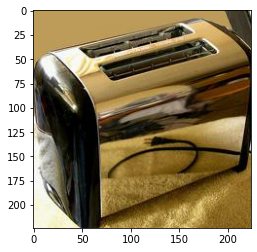

3
['8', '247', '201', '868', '752']


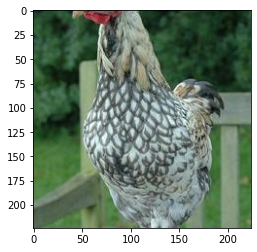

(25, 5)
tf.Tensor([0 0 4 1 4 0 1 4 1 1 4 4 1 4 0 0 4 0 1 4 4 1 0 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 3 1 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 0 0 3 3 0 0 0 3 0 0 3 4 0 0 1 3 3 0 0 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 4 1 1 0 1 1 0 1 1 3 0 0 2 3 0 1 1 1 0 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 1 0 1 1 0 0 0 0 0 0 0 0 0 1 1 4 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 3 0 0 0 0 3 0 1 0 0 0 3 0 0 0 0 0 1 0 1 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 2 1 3 2 1 1 1 3 3 3 2 3 1 3 1 3 2 1 3 1 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 3 1 1 2 3 1 2 1 1 3 3 3 2 3 2 3 2 2 3 3 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 3 1 1 4 3 1 3 1 2 3 3 1 3 2 2 3 2 2 1 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 2 1 4

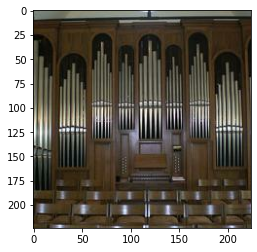

1
['953', '103', '75', '613', '793']


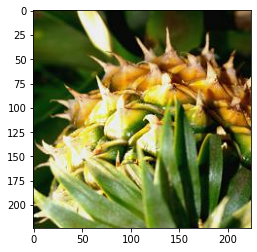

(25, 5)
tf.Tensor([1 1 1 3 1 0 1 1 1 1 0 0 0 1 4 1 0 0 4 4 0 0 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 0 0 0 1 0 0 1 2 0 1 0 0 0 0 0 0 0 2 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 0 3 3 0 3 3 0 3 3 0 0 3 2 1 1 0 1 0 0 1 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 2 0 1 1 1 1 0 1 0 0 1 0 2 1 1 1 1 1 1 2 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 0 1 0 1 1 1 1 1 0 4 0 1 0 0 1 0 1 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 4 1 0 0 1 4 0 1 4 0 4 1 0 1 4 0 4 0 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 3 3 1 1 3 1 0 3 1 1 0 0 0 3 1 3 0 1 1 0 0 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 3 0 0 1 1 0 3 1 1 3 1 1 0 3 0 1 0 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 1 0 1 1 1 0 0 1 1 0 1 0 0 0 0 0 1 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 1 1 0 1 1 1 0 1 0 1 0 1 2 1 0 1 1 1 1 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 1 0 0

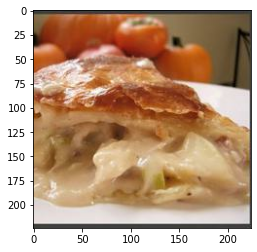

1
['742', '239', '384', '109', '120']


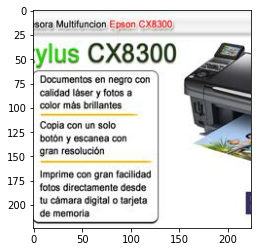

(25, 5)
tf.Tensor([1 1 4 0 1 0 1 0 1 1 0 1 1 1 4 0 4 0 0 1 1 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 2 1 1 1 4 2 1 1 1 2 1 3 4 1 2 1 1 1 3 2 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 4 1 0 0 1 0 1 1 1 0 1 1 1 4 0 0 4 1 3 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 1 0 1 1 1 0 1 0 0 3 3 1 0 0 0 1 1 0 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 1 1 3 2 4 3 3 4 3 4 3 1 1 3 3 1 4 4 4 1 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 4 1 1 0 1 2 2 1 2 4 3 2 2 3 2 3 3 1 1 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 2 4 2 1 2 1 1 1 3 3 2 1 2 1 1 1 4 1 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 3 2 4 4 0 0 0 0 0 0 2 0 0 2 3 2 0 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 3 1 4 3 3 2 3 3 4 2 0 0 0 0 3 4 4 3 0 3 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 2 2 2 2 4 2 0 2 2 0 2 3 3 2 3 4 3 0 4 2 2 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 4 3 3

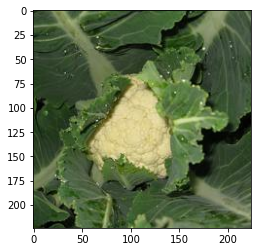

2
['306', '493', '811', '905', '182']


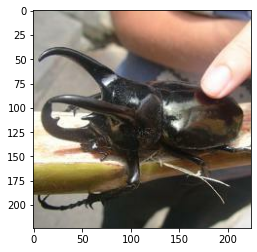

(25, 5)
tf.Tensor([1 1 4 1 4 1 0 1 4 4 1 1 1 1 4 4 1 1 4 1 1 1 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 4 4 4 1 1 1 1 4 1 1 1 2 4 2 2 1 1 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 1 4 0 4 0 4 1 4 0 1 1 4 1 1 4 1 0 4 1 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 4 1 1 1 3 1 3 1 1 1 1 1 1 1 0 4 1 4 1 1 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 1 3 3 1 3 3 3 3 1 2 3 3 3 3 1 4 4 3 3 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 3 3 3 3 1 3 1 3 3 3 1 3 3 3 3 3 3 3 3 1 1 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 0 1 0 1 0 1 0 1 1 0 1 1 1 1 1 0 0 0 4 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 0 4 4 4 0 4 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 0 0 0 0 0 0 1 1 0 0 0 0 0 1 0 1 1 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 0 1

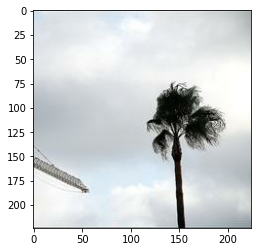

4
['635', '229', '698', '388', '469']


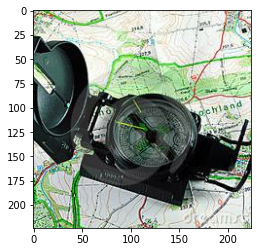

(25, 5)
tf.Tensor([1 3 0 3 2 0 4 0 4 0 3 1 0 3 2 0 3 3 2 0 3 3 4 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 3 0 3 3 3 3 3 0 0 0 0 3 4 3 3 3 3 4 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 3 0 2 3 0 0 3 3 0 3 2 0 3 0 0 0 2 2 2 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 2 2 0 2 2 2 2 2 2 3 2 0 0 2 0 2 2 2 2 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 0 3 2 3 2 1 2 2 4 4 3 3 3 2 3 3 3 0 2 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 2 0 3 4 4 0 4 4 0 4 3 4 3 2 4 2 3 3 2 2 2 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 4 2 2 0 2 4 2 2 2 4 4 2 2 2 2 4 2 4 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 3 1 1 3 0 4 4 0 0 3 3 1 4 1 3 1 3 3 1 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 0 0 3 0 0 0 0 0 0 0 3 0 0 0 0 0 3 0 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 2 3 3 3 3 3 2 4 3 3 3 3 3 3 3 3 3 3 3 3 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 0 0 0

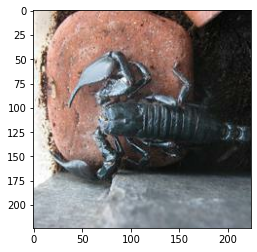

3
['266', '878', '693', '753', '555']


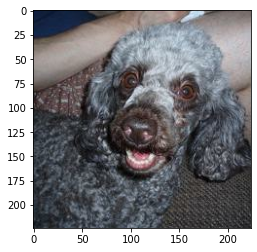

(25, 5)
tf.Tensor([2 0 0 4 0 0 4 3 3 0 0 3 3 3 3 4 3 0 0 3 3 0 0 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 3 3 1 3 4 3 3 3 3 4 3 3 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 1 0 1 1 2 1 4 0 3 3 4 1 1 4 0 1 0 4 1 2 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 0 2 2 2 2 2 2 2 2 2 2 0 2 2 4 2 2 2 2 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 2 0 2 2 4 4 0 0 4 3 4 0 4 1 0 4 4 0 0 3 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 1 3 1 3 1 3 1 1 2 3 3 1 2 3 2 1 1 1 3 2 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 3 3 3 3 3 0 3 3 3 3 3 3 0 3 3 3 3 3 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 4 4 4 4 4 4 4 4 2 4 4 2 4 4 4 4 2 4 1 4 4 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 0 0 0 4 2 0 0 0 0 0 0 4 0 1 2 0 4 0 0 0 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 1 2 4 4 2 4 0 2 0 4 2 2 2 0 4 0 4 2 0 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 4 4 2 4

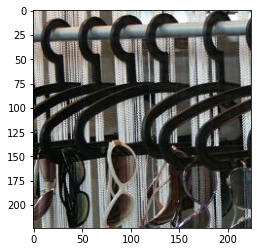

2
['212', '927', '506', '345', '781']


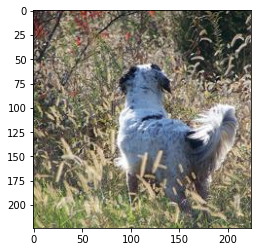

(25, 5)
tf.Tensor([3 3 3 4 0 4 2 0 4 0 2 4 3 1 3 3 3 0 3 4 2 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 3 3 3 4 3 4 4 3 4 3 0 3 3 2 3 2 3 3 4 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 1 2 0 0 2 0 1 1 0 0 2 0 2 2 0 0 2 0 0 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 3 4 4 4 4 4 1 0 4 4 4 4 1 4 4 1 4 1 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 1 0 1 1 0 2 0 4 0 1 4 0 2 0 1 1 4 2 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 0 0 0 1 0 0 1 0 2 2 0 2 1 1 1 0 2 0 0 0 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 4 2 4 1 2 1 4 2 2 2 2 4 2 0 1 4 4 1 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 1 1 4 1 0 4 1 1 1 4 1 1 4 1 1 1 4 1 0 1 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 0 0 2 0 4 0 0 4 4 4 2 2 0 0 2 2 2 0 2 4 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 0 4 2 4 4 0 4 2 2 4 4 4 0 4 0 4 4 0 4 0 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 1 1 0

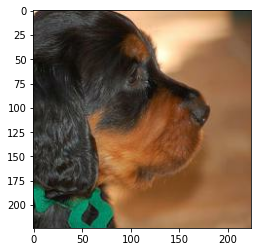

2
['793', '358', '361', '466', '515']


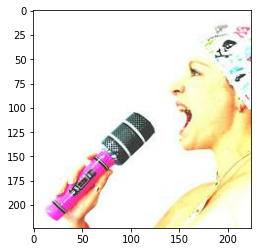

(25, 5)
tf.Tensor([0 3 0 0 0 0 3 0 0 3 0 4 3 0 2 2 4 2 4 3 4 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 0 4 2 4 3 3 3 3 4 4 4 4 3 3 4 3 4 2 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 4 3 3 4 3 0 3 3 3 3 3 4 3 3 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 0 3 4 3 3 0 0 3 3 4 4 3 0 0 4 3 0 0 0 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 1 4 3 4 0 3 3 0 3 0 3 3 0 1 3 3 1 3 1 3 4 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 3 3 4 0 0 4 4 4 0 4 3 3 3 3 4 3 3 0 3 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 4 3 3 3 3 0 0 3 3 3 0 3 0 0 3 3 3 0 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 1 0 3 1 1 1 3 3 1 4 3 1 0 3 4 3 1 1 1 3 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 2 0 4 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 3 4 3 4

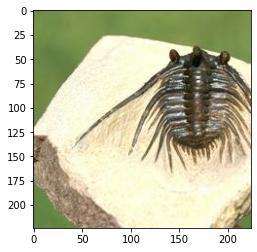

2
['290', '96', '832', '624', '382']


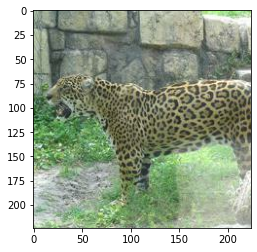

(25, 5)
tf.Tensor([0 4 2 0 0 3 0 0 0 1 0 0 0 3 0 4 4 0 3 3 0 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 3 0 0 0 2 3 3 2 0 0 0 0 0 0 2 0 3 3 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 1 2 4 4 0 2 2 2 4 2 2 3 2 3 2 3 2 1 2 2 3 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 2 1 0 4 2 1 2 1 2 2 0 1 2 2 0 2 4 0 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 0 1 1 0 0 0 2 1 3 1 0 1 2 2 1 1 1 3 1 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 1 1 1 1 2 0 1 2 2 1 0 1 2 2 2 2 2 0 1 0 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 0 2 0 1 2 0 2 0 1 2 2 0 3 0 3 2 0 2 0 1 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 1 2 0 2 0 3 2 2 0 2 0 3 0 0 0 2 0 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 1 2 2 3 3 2 3 2 2 3 3 2 1 1 2 3 3 2 3 3 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 1 3 4 4 1 1 1 1 0 4 1 4 4 1 4 3 1 1 4 1 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 2 3

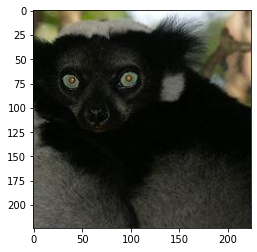

0
['645', '915', '55', '522', '118']


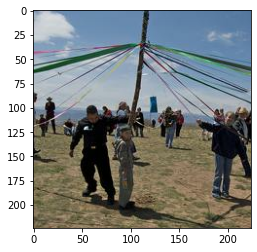

(25, 5)
tf.Tensor([1 4 0 4 2 0 3 3 3 0 4 3 4 0 0 4 3 3 1 0 2 2 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 1 3 1 0 1 1 4 1 1 1 3 3 1 1 3 1 3 1 1 1 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 1 0 4 3 1 0 4 0 0 0 3 0 0 1 0 3 0 0 3 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 2 1 1 1 2 2 2 1 1 2 2 1 1 4 2 2 4 2 1 4 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 0 4 4 4 4 4 4 4 0 0 0 0 0 0 4 0 4 0 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 1 1 4 0 4 2 1 3 4 4 2 4 1 4 1 0 0 4 2 3 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 0 1 4 0 1 1 1 4 4 0 3 4 0 3 0 3 1 1 4 4 3 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 0 0 0 0 2 2 4 2 0 4 4 4 0 0 0 0 0 0 4 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 1 2 0 4 2 4 2 2 0 0 4 2 0 0 0 4 0 2 4 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 0 3 2 4 0 0 0 3 0 0 3 3 2 0 0 3 4 1 0 2 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 0 4 4 4

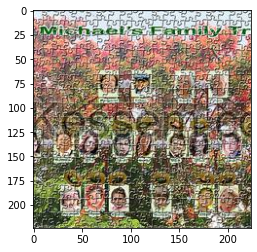

1
['242', '740', '238', '575', '232']


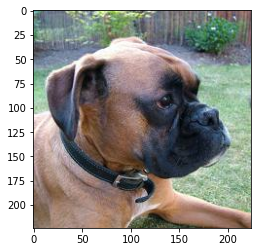

(25, 5)
tf.Tensor([3 3 3 3 0 4 1 3 3 3 1 0 1 1 3 1 0 3 1 1 1 1 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 4 0 0 4 3 4 0 0 3 4 3 4 3 4 4 4 3 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 4 3 3 2 3 4 3 3 0 3 3 3 4 0 4 0 4 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 1 0 1 1 1 1 1 2 0 0 1 1 0 1 1 0 1 0 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 2 2 1 3 1 3 3 1 3 3 1 1 3 2 3 1 1 1 1 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 3 3 0 3 0 3 2 0 3 0 1 2 1 3 3 1 3 0 3 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 2 0 1 1 0 0 0 0 0 1 0 0 0 3 0 0 0 1 0 1 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 0 1 1 1 1 1 1 0 1 3 0 1 0 0 0 0 1 0 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 2 2 0 2

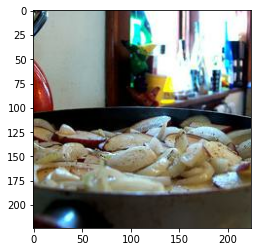

0
['795', '110', '913', '14', '40']


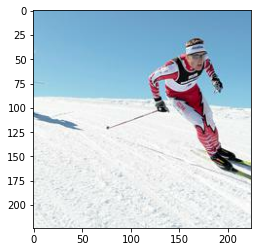

(25, 5)
tf.Tensor([3 3 3 3 3 3 3 0 3 3 4 3 4 2 0 3 0 0 0 0 0 3 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 2 3 2 2 2 0 2 2 3 3 3 0 2 2 0 2 2 1 3 2 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 0 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 1 1 4 1 4 1 1 1 1 2 2 1 1 2 4 4 1 4 1 1 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 2 2 4 2 0 2 4 0 2 2 4 4 4 2 2 4 4 4 4 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 2 1 2 1 2 2 4 2 4 4 1 4 0 2 2 4 2 2 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 1 4 4 1 1 4 1 1 1 1 4 1 4 0 0 4 4 0 0 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 0 0 4 4 0 4 4 4 4 4 0 0 4 4 4 4 0 0 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 4 4 0 3 0 0 1 1 4 0 0 4 0 4 3 4 3 1 0 0 0 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 4 0 3 3 0 1 3 1 3 0 1 0 1 0 1 0 0 1 1 1 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 3 0 4 4

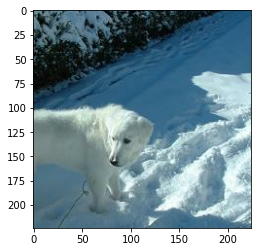

1
['346', '760', '84', '446', '460']


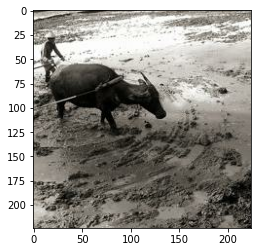

(25, 5)
tf.Tensor([3 3 3 3 4 3 3 3 4 4 4 3 2 2 2 3 3 0 0 3 3 3 3 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 0 0 1 0 0 4 3 4 0 0 3 0 0 3 3 0 1 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 0 0 4 0 0 0 4 4 0 0 4 0 1 4 4 0 0 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 4 3 1 4 1 4 3 3 3 1 0 3 1 1 0 3 0 0 3 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 3 3 0 3 3 4 3 3 4 3 4 2 4 3 4 4 3 3 3 3 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 1 3 2 4 3 4 4 2 2 0 1 1 1 4 3 3 3 4 3 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 4 0 4 4 4 4 4 4 4 4 4 4 0 1 4 2 2 4 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 4 1 0 0 1 0 4 0 0 0 1 1 0 0 1 1 0 4 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 0 3 2 0 0 3 3 0 3 2 3 2 3 3 3 3 0 0 0 2 3 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 4 3 4 0 0 2 4 0 0 0 0 3 3 4 0 4 0 3 4 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 0 3 3 3

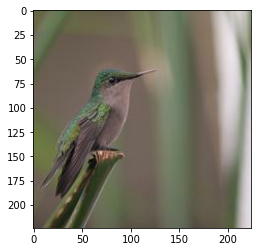

0
['463', '11', '635', '351', '118']


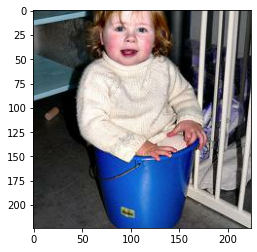

(25, 5)
tf.Tensor([1 2 0 0 2 3 0 1 3 1 0 1 0 0 0 3 1 1 3 3 3 3 0 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 3 4 3 2 4 4 0 4 4 4 4 2 3 0 4 4 4 3 3 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 4 2 2 2 2 2 4 4 2 2 2 2 2 2 2 2 2 4 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 4 2 2 2 4 2 2 2 4 2 2 2 2 2 4 2 0 2 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 0 0 0 0 0 2 4 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 4 4 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 4 4 0 0 0 0 4 0 0 4 4 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 3 3 3 3 0 4 0 0 0 2 4 4 0 0 3 4 3 0 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 3 3 1 4 3 2 1 3 4 2 0 4 2 2 4 4 2 1 0 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 0 0 1 1 1 1 1 1 0 4 3 0 1 1 1 2 1 2 0 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 0 1 1

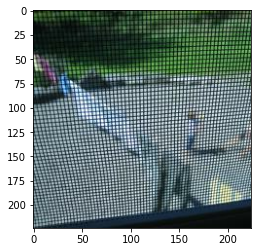

4
['284', '869', '531', '819', '429']


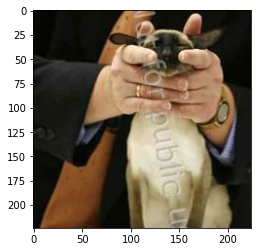

(25, 5)
tf.Tensor([0 2 3 1 4 2 4 0 0 4 0 0 0 0 3 3 2 0 0 4 2 2 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 3 4 3 3 4 1 2 0 3 3 3 2 4 2 3 4 4 1 3 4 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 3 3 3 3 3 0 4 3 3 0 3 0 0 0 3 3 3 3 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 0 3 2 4 2 3 3 3 3 2 4 2 3 2 3 3 0 2 2 3 4 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 3 1 4 4 3 3 2 0 3 3 3 2 2 0 2 2 3 0 3 3 3 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 2 3 3 0 2 2 2 2 3 0 0 3 0 2 0 3 2 3 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 2 3 4 4 4 2 4 4 4 3 2 4 4 2 2 4 3 4 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 3 3 0 3 1 0 3 0 4 3 3 3 0 4 3 2 3 1 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 2 2 2 2 0 1 0 0 0 2 2 1 2 1 2 0 1 2 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 1 2 1 2 1 1 1 2 2 2 1 1 0 2 1 3 2 2 2 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 3 4 3 2

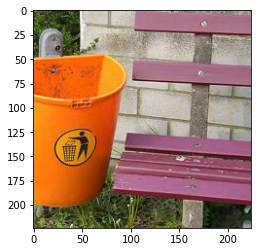

3
['609', '786', '349', '929', '857']


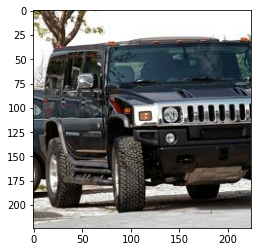

(25, 5)
tf.Tensor([4 0 4 3 3 4 1 0 0 4 3 4 4 3 0 0 4 4 0 0 3 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 3 4 4 4 4 4 4 4 4 4 4 4 4 0 3 4 4 3 4 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 4 4 0 0 4 0 4 1 0 0 0 0 0 1 4 0 0 0 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 2 4 0 0 0 4 0 4 0 0 0 4 0 4 0 0 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 3 3 0 2 0 0 0 0 0 2 1 0 0 0 0 0 0 4 2 1 3 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 0 0 0 0 4 0 0 0 4 0 0 0 0 0 0 0 0 4 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 2 4 3 0 0 0 0 4 4 2 4 0 4 0 3 4 1 0 1 1 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 1 2 4 0 1 2 2 1 4 1 2 2 0 1 0 2 4 2 0 4 1 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 3 3 3 3 3 2 3 3 0 2 3 2 2 4 2 2 3 3 3 0 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 0 2 3 2 2 4 0 2 2 2 3 4 4 3 4 4 2 2 2 3 4 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 3 0 3

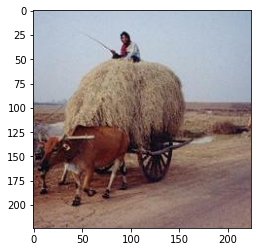

2
['419', '638', '494', '720', '384']


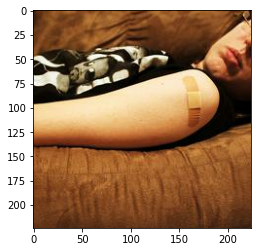

(25, 5)
tf.Tensor([0 4 4 2 4 4 4 4 4 3 0 4 4 2 0 2 0 4 2 0 4 4 2 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 3 0 3 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 1 1 0 0 1 1 1 0 0 0 0 1 0 0 1 0 1 1 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 0 0 2 0 0 2 0 2 2 2 0 0 2 2 0 0 1 2 1 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 1 1 3 1 0 1 0 2 1 1 3 0 0 0 0 1 1 0 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 1 1 2 1 0 1 1 1 1 2 0 2 0 1 2 3 0 0 1 2 1 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 1 1 0 0 2 2 2 2 2 2 0 2 1 2 2 2 2 2 0 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 0 1 0 4 0 1 0 1 1 1 0 0 0 0 1 0 4 1 0 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 2 0 0 3 3 2 0 1 1 3 2 0 1 1 0 4 0 3 0 0 1 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 0 0 0 3 3 2 0 3 0 0 0 0 3 3 0 0 0 0 3 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 4 0 0

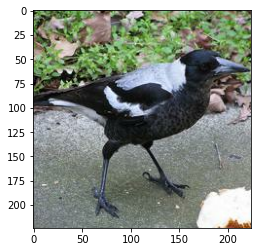

1
['816', '296', '686', '115', '130']


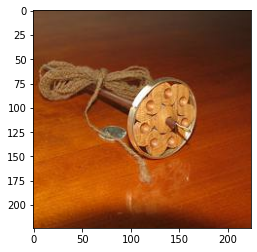

(25, 5)
tf.Tensor([2 4 0 3 0 2 0 0 0 0 3 1 2 2 0 0 1 2 4 2 4 1 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 0 0 0 0 0 0 1 0 1 1 0 1 1 0 1 0 1 0 0 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 3 4 3 0 3 3 3 4 3 3 4 4 3 1 1 3 3 4 3 2 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 0 0 0 0 0 0 1 0 0 1 0 0 0 1 1 0 0 0 0 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 2 2 2 2 1 2 2 2 2 2 2 0 1 0 2 1 2 2 4 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 3 2 2 2 2 2 1 2 4 4 2 4 2 1 2 2 4 2 4 3 3 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 4 3 4 3 1 4 2 0 0 1 3 2 4 3 1 1 3 0 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 1 0 4 4 0 1 0 3 4 4 0 0 4 0 4 4 2 4 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 1 1 1 1 2 4 3 3 2 4 1 1 3 1 3 2 2 1 1 3 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 3 3 3 3 3 3 3 3 3 3 3 1 3 1 3 2 1 1 2 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 1 2 2 2

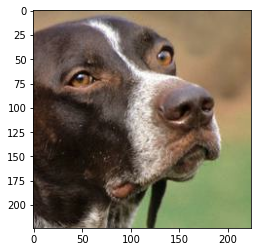

1
['108', '451', '132', '127', '593']


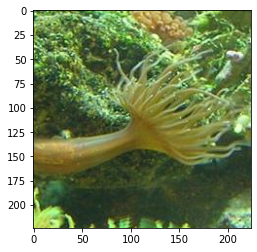

(25, 5)
tf.Tensor([4 1 4 1 0 2 1 0 2 4 1 0 1 4 1 0 2 2 4 0 0 0 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 4 4 4 1 2 4 0 2 4 1 4 4 4 3 2 1 0 4 4 1 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 0 0 0 2 0 0 2 0 0 0 0 0 4 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 4 4 0 0 4 4 4 4 1 1 4 0 0 0 4 0 0 4 0 3 1 3 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 3 3 3 0 3 0 0 3 3 3 3 3 0 0 0 4 0 3 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 2 2 4 2 2 4 4 4 4 2 2 4 4 4 4 4 2 4 2 4 2 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 1 4 1 1 1 1 0 1 3 0 1 4 0 1 3 1 3 1 3 3 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 3 0 4 3 3 3 1 1 0 1 0 3 0 1 0 4 1 4 0 0 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 3 0 0 0 0 0 1 0 0 0 3 3 0 1 0 0 0 0 3 3 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 1 3 0 1 1 1 3 3 1 3 1 1 1 4 0 3 3 3 3 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 0 0 1

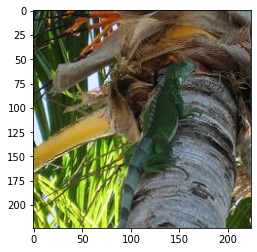

4
['339', '12', '467', '140', '921']


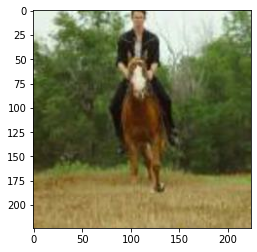

(25, 5)
tf.Tensor([0 0 0 0 4 2 0 0 0 2 2 4 0 0 2 0 4 2 1 1 4 0 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 0 0 0 1 0 0 0 0 1 1 1 0 1 0 0 0 0 0 1 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 0 4 4 4 4 0 0 0 0 4 1 0 4 0 1 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 3 0 0 4 0 4 4 0 3 3 4 2 0 4 4 3 0 3 0 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 1 1 1 2 1 1 3 2 3 4 3 2 2 1 2 1 1 2 1 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 1 4 4 3 2 3 1 1 1 3 1 2 3 3 2 1 4 1 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 1 1 1 1 2 2 2 1 2 2 1 4 2 2 1 2 2 4 1 1 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 1 2 1 2 2 1 2 0 1 1 0 0 0 1 2 2 0 1 2 1 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 2 2 2 3 3 2 3 2 3 3 0 2 2 3 3 3 3 4 1 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 1 1 3 2 3 3 2 3 2 4 2 2 2 3 2 1 3 3 2 2 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 0 1 3 3

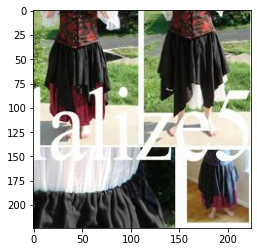

2
['394', '631', '897', '819', '861']


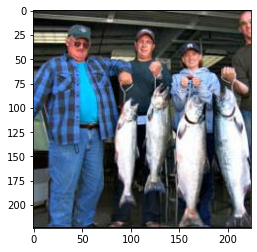

(25, 5)
tf.Tensor([4 1 4 4 1 1 1 0 4 3 3 2 1 3 1 3 1 0 1 1 1 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 0 0 2 2 0 2 2 3 3 3 2 2 0 0 2 0 0 2 2 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 3 3 0 1 0 1 3 1 1 1 3 1 3 1 0 3 1 1 4 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 3 1 3 1 1 3 3 3 1 3 3 3 3 3 3 1 1 1 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 4 1 0 0 3 3 0 1 0 3 0 3 3 3 0 0 0 0 1 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 1 3 2 0 3 3 3 2 3 0 3 2 0 0 0 0 3 0 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 1 1 0 0 0 0 0 0 0 4 1 4 0 0 4 0 1 1 0 4 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 1 1 3 3 2 1 3 3 4 4 2 3 4 2 3 3 3 3 3 3 3 2 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 4 4 1 1 3 3 0 3 2 3 3 2 3 3 2 3 3 4 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 2 0 4 4 0 0 3 0 4 4 2 0 4 2 4 0 4 2 3 4 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 3 2 3

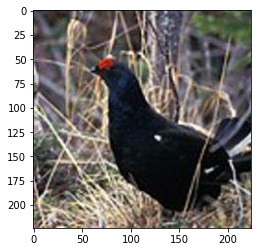

1
['798', '617', '902', '659', '924']


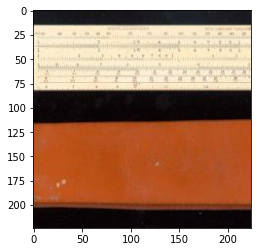

(25, 5)
tf.Tensor([1 0 4 3 3 1 1 0 1 3 1 3 4 3 4 1 3 1 4 0 0 0 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 4 1 2 4 1 2 3 2 4 2 4 4 2 1 2 4 3 1 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 2 2 3 3 2 4 2 2 4 2 4 2 2 3 2 4 2 2 2 3 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 2 3 3 2 3 0 3 2 0 2 0 3 3 3 2 3 2 3 3 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 1 2 4 4 4 4 2 4 4 4 4 0 4 4 4 4 4 4 1 0 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 0 2 2 4 2 2 4 0 2 0 0 0 2 2 2 2 4 0 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 3 2 4 2 2 2 2 2 2 4 3 2 2 2 4 2 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 4 0 1 4 4 2 4 4 1 1 2 4 4 1 4 1 4 2 2 4 4 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 4 1 0 1 1 1 3 2 1 1 1 4 4 4 4 4 3 3 3 1 2 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 2 3 2 2 2 1 2 2 2 2 2 4 2 2 2 3 2 0 2 3 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 4 4 4

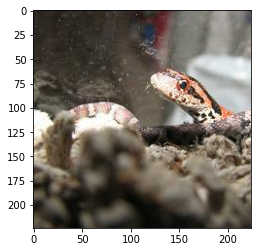

5
['811', '271', '698', '307', '452']


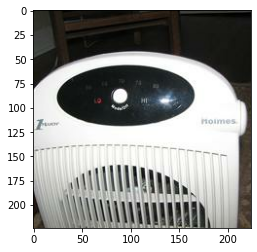

(25, 5)
tf.Tensor([3 1 0 1 0 1 2 1 3 0 3 1 3 1 4 0 3 2 0 1 3 4 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 1 4 0 2 4 2 4 2 4 4 0 0 2 2 1 2 2 2 0 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 4 2 4 2 2 4 2 4 2 4 2 2 2 4 4 4 2 2 4 4 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 4 4 4 2 2 4 4 4 4 4 2 4 4 4 0 4 2 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 4 0 2 4 0 0 4 3 4 3 1 2 0 2 1 3 0 3 0 2 1 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 2 3 3 3 3 0 2 4 3 3 3 3 2 3 2 3 3 2 3 3 0 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 3 3 3 0 0 3 0 3 0 0 4 4 3 2 3 0 3 0 3 4 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 2 2 2 2 1 1 3 2 0 1 2 2 1 1 2 1 2 2 2 1 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 4 4 0 1 3 4 1 3 3 4 1 4 3 4 1 4 0 4 3 4 3 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 3 1 4 3 4 4 1 1 1 1 1 0 0 0 4 1 3 3 3 4 1 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 3 1 2

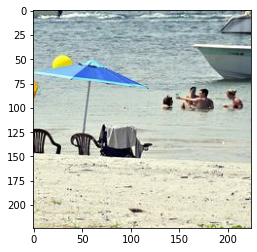

4
batch 100: train=0.800000
['70', '831', '355', '153', '525']


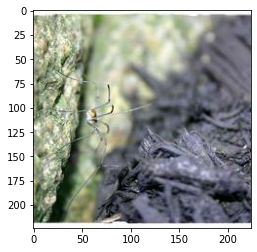

(25, 5)
tf.Tensor([3 0 2 0 4 4 0 0 1 4 0 4 0 2 4 2 4 0 0 2 0 4 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 0 0 0 0 2 2 0 0 2 0 2 0 2 0 2 2 0 2 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 3 0 0 1 1 1 3 1 0 3 1 0 1 0 0 1 3 2 0 3 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 0 1 0 0 1 4 0 4 4 4 0 4 4 4 1 4 4 4 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 1 4 1 4 3 1 1 1 1 0 1 1 0 4 1 4 4 1 0 4 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 4 4 0 3 4 0 3 4 4 1 4 1 4 4 1 0 0 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 4 1 3 4 3 4 1 4 4 1 4 0 1 1 1 0 3 0 1 1 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 0 4 4 0 0 4 4 4 0 1 4 0 4 0 0 4 4 4 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 0 4 0 4 4 1 4 4 4 4 1 4 4 4 4 4 4 0 4 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 0 4 3 0 3 1 0 0 4 4 0 0 0 0 0 4 0 4 0 0 0 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 4 0 1

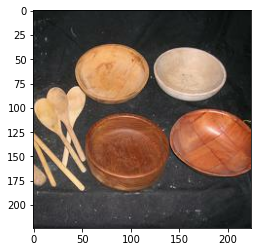

2
['341', '854', '526', '697', '90']


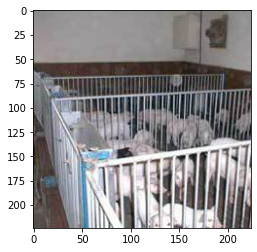

(25, 5)
tf.Tensor([2 2 2 2 0 2 1 1 3 1 1 4 2 3 1 0 0 0 2 2 2 2 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 1 3 3 3 3 3 3 1 1 3 3 3 3 3 3 3 1 3 3 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 0 4 0 0 4 0 4 4 4 4 0 4 4 0 4 4 4 4 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 1 1 1 2 0 0 0 0 0 1 0 2 1 1 0 0 0 0 0 0 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 1 1 1 1 2 0 0 2 2 1 1 1 2 0 0 0 1 0 1 2 0 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 3 0 2 3 0 2 3 3 3 2 3 4 0 2 3 3 3 2 2 2 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 3 3 2 3 3 0 3 0 2 3 2 2 2 2 2 0 3 0 2 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 1 1 0 0 1 2 1 1 1 1 0 0 1 0 1 0 1 2 0 1 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 4 1 0 4 0 0 0 1 1 0 0 0 1 4 0 0 2 0 4 2 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 0 2 4 2 2 2 2 0 2 2 2 1 1 4 2 4 4 4 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 1 1 1 4

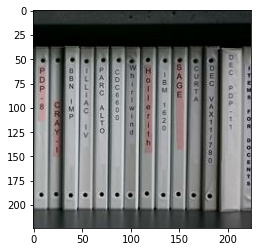

0
['107', '376', '428', '962', '61']


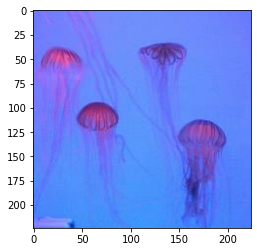

(25, 5)
tf.Tensor([0 0 0 0 0 0 2 2 4 4 0 0 2 4 1 2 0 4 2 4 2 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 0 3 0 3 3 0 0 0 0 0 0 0 3 3 3 0 0 0 0 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 0 3 3 3 0 0 3 0 3 3 3 0 0 0 3 3 0 0 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 4 4 0 0 0 2 0 0 2 4 4 2 2 4 0 4 0 4 4 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 3 2 2 2 2 2 2 0 0 0 2 0 2 0 2 2 3 0 3 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 0 3 3 2 3 2 3 3 0 3 3 0 3 3 2 2 3 0 2 3 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 2 3 2 3 3 0 3 0 2 2 3 3 3 0 2 0 2 2 3 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 0 2 2 3 0 3 3 3 3 2 0 3 3 0 2 0 3 0 2 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 0 4 0 2 0 2 2 0 0 4 0 0 2 2 2 4 2 0 2 4 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 4 4 4 0 4 0 4 1 4 4 0 0 1 4 1 0 0 1 4 0 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 2 2 2 4

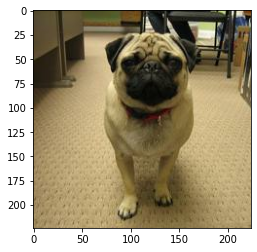

1
['364', '309', '768', '143', '158']


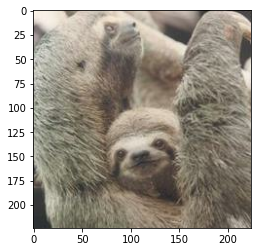

(25, 5)
tf.Tensor([2 2 0 2 4 2 2 4 0 2 0 1 4 2 2 2 2 0 2 0 4 2 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 2 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 2 2 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 1 0 3 1 1 1 1 1 1 1 1 1 1 3 1 1 3 1 1 3 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 4 4 4 4 2 3 4 1 4 2 4 4 4 0 1 1 1 4 4 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 1 1 0 0 0 1 1 1 1 2 0 1 1 0 0 0 3 0 0 3 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 2 1 2 2 2 2 2 1 2 3 1 1 3 1 3 2 3 2 3 2 2 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 3 1 0 1 0 0 1 0 1 1 3 1 1 1 1 3 3 1 1 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 0 3 0 0 1 1 0 3 1 0 0 0 0 3 0 1 1 3 1 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 1 0 1 3 4 0 4 4 0 1 3 3 4 4 3 3 4 3 3 4 3 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 0 1 3 1 1 3 0 3 4 1 0 1 1 3 3 1 1 3 3 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 3 3 0

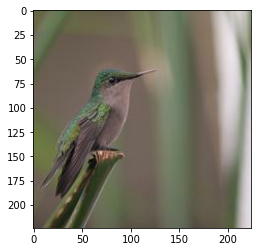

2
['807', '577', '499', '710', '154']


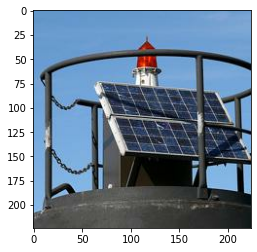

(25, 5)
tf.Tensor([1 2 2 0 0 4 0 0 0 1 4 0 0 2 0 0 0 0 2 0 4 2 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 0 0 3 3 0 0 0 3 3 0 0 3 0 0 0 3 0 3 3 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 0 2 3 3 0 0 0 0 3 3 2 3 3 3 3 3 0 2 3 0 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 0 3 3 2 0 3 3 3 0 3 0 0 0 0 2 3 0 3 0 3 0 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 3 0 0 0 0 2 2 4 2 0 2 3 4 0 2 0 2 0 0 2 2 4 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 4 2 2 4 4 2 2 4 0 4 4 2 4 0 0 0 0 3 4 0 2 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 3 3 3 1 0 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 1 3 0 3 3 3 0 0 1 3 3 1 1 0 1 1 0 1 1 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 1 0 3 4 3 0 0 1 2 1 3 1 1 1 0 0 4 3 3 3 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 1 2 1 1 1 1 1 1 4 1 1 4 0 1 4 2 2 4 1 0 4 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 1 2 4 2 2

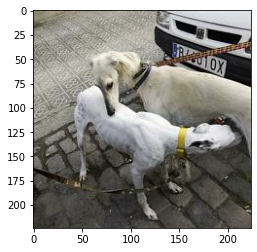

3
['599', '722', '718', '125', '868']


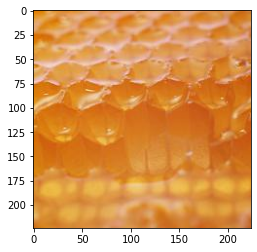

(25, 5)
tf.Tensor([0 0 4 1 0 4 4 0 1 1 1 2 2 4 0 2 0 0 2 0 2 2 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 2 2 0 0 2 2 0 0 0 2 2 2 2 0 0 2 2 0 2 2 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 2 0 2 0 2 0 2 2 0 0 2 0 0 2 2 0 2 0 2 0 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 3 0 3 0 0 0 0 2 3 3 4 0 3 0 4 0 0 0 4 3 2 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 4 0 0 0 0 0 0 3 2 2 0 4 2 4 2 0 0 2 2 0 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 1 0 2 1 2 1 3 0 1 2 2 3 3 1 2 3 2 2 3 2 2 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 4 1 4 0 0 0 4 3 4 4 4 2 4 0 0 4 1 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 0 0 3 0 2 4 0 0 0 3 3 1 0 1 2 3 2 3 2 3 3 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 2 3 2 4 2 0 2 0 1 3 3 2 3 0 0 0 2 3 1 0 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 3 1 3 3 4

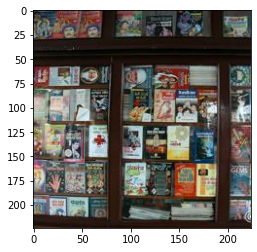

4
['38', '5', '530', '229', '292']


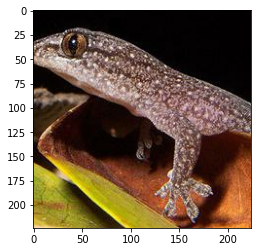

(25, 5)
tf.Tensor([0 0 0 1 4 0 4 4 2 0 0 3 2 0 0 2 2 0 3 2 2 3 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 4 1 0 1 1 1 1 1 1 0 1 4 1 1 1 1 1 1 4 4 1 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 1 1 1 1 4 4 4 1 1 4 4 4 4 1 1 1 1 1 1 4 4 4 1 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 4 4 0 2 4 4 4 4 0 4 4 4 0 4 4 2 2 4 0 4 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 1 0 0 0 3 0 0 0 0 0 0 0 1 0 3 0 0 0 0 0 0 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 0 0 0 0 4 1 0 4 4 4 1 4 4 4 4 0 0 4 0 1 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 3 3 2 3 1 1 2 3 2 1 2 2 2 1 2 2 3 3 2 2 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 2 2 1 2 0 1 0 2 4 0 2 0 0 4 0 0 0 1 0 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 1 2 0 2 1 2 2 0 1 2 2 0 2 0 1 2 1 2 0 1 2 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 2 2 2 2 0 2 1 2 2 3 2 2 2 2 0 3 2 3 0 2 1 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 0 3 1

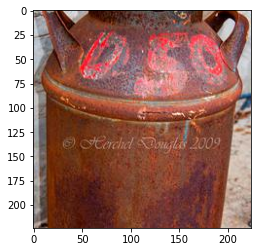

1
['113', '967', '509', '880', '814']


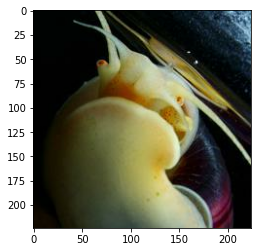

(25, 5)
tf.Tensor([1 4 4 4 4 3 4 4 4 4 4 4 4 4 1 3 4 4 4 4 1 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 0 0 2 0 0 1 1 0 2 0 4 2 0 0 0 0 0 0 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 4 0 0 2 0 0 0 0 0 0 0 4 1 0 0 4 1 0 2 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 3 3 3 3 3 3 1 1 3 1 3 3 3 1 3 3 3 3 1 1 1 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 2 4 2 4 4 4 2 2 4 4 2 2 4 4 4 4 4 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 2 4 4 4 2 4 4 0 2 2 2 2 2 0 3 3 3 2 4 0 4 2 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 2 2 2 2 4 0 2 4 2 2 4 4 2 0 2 2 4 2 4 4 2 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 4 1 0 1 1 1 4 1 4 1 1 0 4 1 4 1 1 4 0 4 1 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 4 0 4 0 4 0 4 0 0 0 0 4 1 0 4 0 0 0 4 4 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 0 4 4 3 3 1 4 4 4 2 4 1 4 3 1 4 1 1 1 4 4 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 4 2 4 2

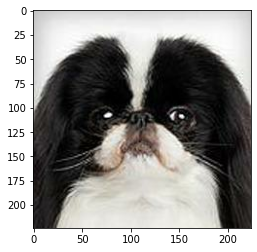

1
['32', '281', '408', '354', '850']


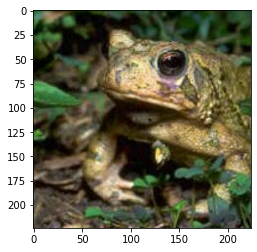

(25, 5)
tf.Tensor([0 3 0 0 0 4 1 3 1 1 1 3 3 0 3 0 0 1 3 3 3 0 0 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 4 1 4 4 4 4 4 4 3 4 4 3 4 4 4 3 4 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 2 2 2 4 4 1 2 2 3 2 4 3 3 4 2 2 3 1 4 4 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 0 2 0 4 4 0 2 4 2 4 2 0 4 0 4 0 0 4 2 4 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 4 0 4 0 1 0 0 4 0 0 0 4 0 0 0 0 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 2 1 2 2 1 4 2 4 4 4 2 2 2 2 4 0 4 2 2 0 2 4 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 1 4 0 4 1 4 4 1 4 4 1 4 4 4 2 1 0 1 1 2 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 0 0 0 2 0 0 0 4 0 0 0 0 0 0 0 0 0 0 0 0 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 2 4 3 4 3 0 2 0 2 2 2 2 4 3 2 0 3 3 2 0 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 4 4 4 3 3 3 3 3 0 4 4 4 3 3 3 3 4 4 0 3 3 4 3 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 0 4

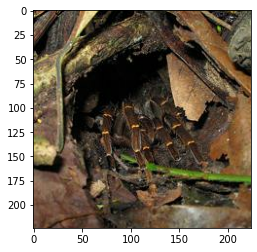

2
['724', '787', '192', '323', '679']


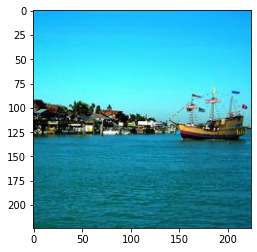

(25, 5)
tf.Tensor([3 0 4 0 0 0 3 3 1 3 3 3 0 0 4 1 1 1 0 3 0 4 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 3 3 2 3 3 3 3 3 3 1 3 3 3 3 3 3 3 3 1 3 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 3 0 0 3 0 0 0 3 0 3 3 3 0 1 3 3 0 0 3 1 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 4 0 3 0 3 3 0 0 0 3 3 3 3 0 3 0 0 1 0 0 3 0 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 3 0 0 3 3 3 0 0 0 3 0 0 3 2 0 2 0 3 0 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 2 0 0 2 0 4 0 4 2 0 2 2 0 3 3 3 0 0 3 3 3 3 2 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 3 3 3 4 3 3 3 3 0 1 3 0 0 3 0 3 0 3 0 3 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 1 0 0 3 3 0 0 4 1 3 3 0 0 3 3 3 3 0 0 0 3 3 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 0 4 2 0 0 1 0 0 0 0 0 2 0 0 0 2 0 0 4 2 1 4 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 1 3 1 4 3 4 4 3 4 2 2 4 3 2 3 4 2 1 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 0 0 2 0 0

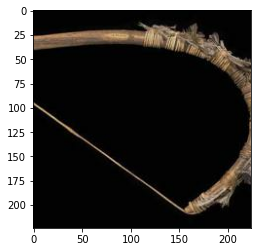

0
['641', '934', '450', '920', '7']


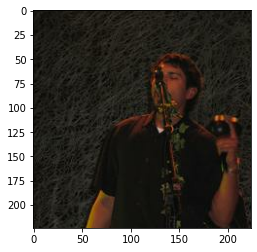

(25, 5)
tf.Tensor([4 2 4 1 3 0 4 2 4 1 4 3 1 1 4 3 3 1 4 3 1 0 1 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 0 0 0 3 1 0 1 3 1 1 3 3 0 1 0 2 2 0 3 3 0 3 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 2 3 0 3 3 0 3 2 3 0 2 3 3 0 0 0 0 3 0 0 0 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 4 4 4 4 4 2 3 4 4 4 4 4 4 4 4 4 3 3 4 4 4 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 1 1 1 1 3 3 1 1 1 1 3 3 1 4 4 0 1 3 1 1 3 1 3], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 1 0 1 1 3 1 3 1 3 3 1 1 1 1 3 1 1 3 1 3 1 4 4 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 0 3 0 3 0 3 2 0 3 0 3 0 3 3 0 1 3 3 0 0 0 3 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 2 1 0 2 3 3 3 2 2 3 1 0 0 3 1 1 3 1 3 3 0 0 1 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 3 3 1 0 1 4 0 3 3 0 0 0 4 4 3 1 4 1 1 3 2 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([1 1 1 0 2 2 1 1 1 2 1 1 3 3 0 1 3 2 1 0 1 2 2 1 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 0 0 3 2

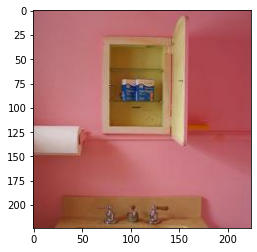

2
['539', '594', '957', '200', '865']


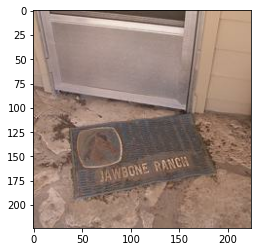

(25, 5)
tf.Tensor([1 4 1 4 3 4 4 1 0 2 1 4 0 4 1 1 2 2 2 3 4 4 4 0 1], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 0 2 2 3 0 0 0 3 2 0 3 3 0 2 0 2 0 0 3 0 1 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([3 2 2 2 2 2 3 2 2 2 2 3 3 3 2 2 2 2 2 2 2 2 0 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([2 2 3 2 2 2 2 4 2 2 3 2 4 3 4 2 4 2 2 2 3 3 3 2 2], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([4 3 4 3 4 4 0 3 4 4 3 1 4 0 3 4 4 4 4 0 0 4 0 0 4], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 3 0 0 0 0 0 0 0 0 3 4 0 3 0 0 0 4 0 0 4 2 0 0 0], shape=(25,), dtype=int64)
(25, 5)
tf.Tensor([0 1 3 1 3 3 3 1 0 3 3 0 2 0 2 2 2 1 1 0 2 3 2 3 1], shape=(25,), dtype=int64)


KeyboardInterrupt: ignored

In [ ]:
training = []
testing = []
for meta_iter in range(meta_iters):
    frac_done = meta_iter / meta_iters
    cur_meta_step_size = (1 - frac_done) * meta_step_size
    # Temporarily save the weights from the model.
    old_vars = model.get_weights()
    # Get a sample from the full dataset.
    mini_dataset = train_dataset.get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)
    #mini_dataset = get_mini_dataset(inner_batch_size, inner_iters, train_shots, classes)
    for images, labels in mini_dataset:
        with tf.GradientTape() as tape:
            preds = model(images)
            print(preds.shape)
            print(tf.math.argmax(preds,axis = 1))
            loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
            #print(loss)
        grads = tape.gradient(loss, model.trainable_weights)
        optimizer.apply_gradients(zip(grads, model.trainable_weights))
    new_vars = model.get_weights()
    # Perform SGD for the meta step.
    for var in range(len(new_vars)):
        new_vars[var] = old_vars[var] + (
            (new_vars[var] - old_vars[var]) * cur_meta_step_size
        )
    # After the meta-learning step, reload the newly-trained weights into the model.
    model.set_weights(new_vars)
    # Evaluation loop
    if meta_iter % eval_interval == 0:
        accuracies = []
        for dataset in [train_dataset]:
            # Sample a mini dataset from the full dataset.
            train_set, test_images, test_labels = train_dataset.get_mini_dataset(
                eval_batch_size, eval_iters, shots, classes, split=True
            )
            old_vars = model.get_weights()
            # Train on the samples and get the resulting accuracies.
            for images, labels in train_set:
                with tf.GradientTape() as tape:
                    preds = model(images)
                    loss = keras.losses.sparse_categorical_crossentropy(labels, preds)
                grads = tape.gradient(loss, model.trainable_weights)
                optimizer.apply_gradients(zip(grads, model.trainable_weights))
            test_preds = model.predict(test_images)
            test_preds = tf.argmax(test_preds).numpy()
            num_correct = (test_preds == test_labels).sum()
            print(num_correct)
            # Reset the weights after getting the evaluation accuracies.
            model.set_weights(old_vars)
            accuracies.append(num_correct / classes)
        training.append(accuracies)
        #testing.append(accuracies[1])
        if meta_iter % 100 == 0:
            print(
                "batch %d: train=%f" % (meta_iter, accuracies[0])
            )

AttributeError: ignored